In [1]:
import pandas as pd
import pyarrow, fastparquet
import numpy as np
import matplotlib.pyplot as plt

In [2]:
original_df = pd.read_csv('train.csv')

In [3]:
df = pd.read_csv('metadata.csv')

### Data Overview: Metadata  
  
The training data .csv is metadata for the critically ill patient EEG and spectrogram data and originally contains 106.8k rows. There are 17.3k individual EEGs and 11.1k individual spectrograms. There are 1950 unique patients. This training data will be split into training, validation, and testing data. The testing data provided with the project is a single sub EEG and sub spectrogram for submitting a prediction. The same metadata is provided for those other than the expert classification.  
  
Each row gives the eeg ID which is used to load in the specific eeg parquet, the eeg sub ID, the eeg label offset seconds which tells you when that row's sub EEG starts in the overall EEG, and each row contains this same information for spectrograms. Each row also gives the label ID, the patient ID, the expert_consensus, and how many experts voted for each of the six classes of the target variable.  
  
The target variable is brain activity type. There are six classes: Seizure, Lateralized Periodic Discharge (LPD), Generalized Periodic Discharge (GPD), Lateralized Rhythmic Delta Activity (LRDA), Generaliized Rhythmic Delta Activity (GRDA), and Other (this is an umbrella category for any activity that doesn't fit one of the five activity types of interest).

In [4]:
original_df

,eeg_id,eeg_sub_id,eeg_label_offset_seconds,spectrogram_id,spectrogram_sub_id,spectrogram_label_offset_seconds,label_id,patient_id,expert_consensus,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote
0,1628180742,0,0.0,353733,0,0.0,127492639,42516,Seizure,3,0,0,0,0,0
1,1628180742,1,6.0,353733,1,6.0,3887563113,42516,Seizure,3,0,0,0,0,0
2,1628180742,2,8.0,353733,2,8.0,1142670488,42516,Seizure,3,0,0,0,0,0
3,1628180742,3,18.0,353733,3,18.0,2718991173,42516,Seizure,3,0,0,0,0,0
4,1628180742,4,24.0,353733,4,24.0,3080632009,42516,Seizure,3,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
106795,351917269,6,12.0,2147388374,6,12.0,4195677307,10351,LRDA,0,0,0,3,0,0
106796,351917269,7,14.0,2147388374,7,14.0,290896675,10351,LRDA,0,0,0,3,0,0
106797,351917269,8,16.0,2147388374,8,16.0,461435451,10351,LRDA,0,0,0,3,0,0
106798,351917269,9,18.0,2147388374,9,18.0,3786213131,10351,LRDA,0,0,0,3,0,0


In [5]:
np.unique(df['expert_consensus'])

array(['GPD', 'GRDA', 'LPD', 'LRDA', 'Other', 'Seizure'], dtype=object)

My computer will not handle this much data, so I'm going to be using a smaller subset of the data for modeling. I wrote code to calculate the ratio of missing values to total values for each individual EEG and spectrogram and then removed the EEGs and spectrograms with more than 10% missing values. The result of this was a reduction of rows from 106.8k to 99.7k. In this reduced dataset, there are 15.8k EEGs, 10.4k spectrograms, and 1822 unique patients.  
  
I may remove any EEG and spectrogram with missing values because 99.7k is still a lot more data than I'll be working with. I'll want to determine how many rows that would remove and what impact that would have on the balance of the target variable distribution.

In [6]:
df

,eeg_id,eeg_sub_id,eeg_label_offset_seconds,spectrogram_id,spectrogram_sub_id,spectrogram_label_offset_seconds,label_id,patient_id,expert_consensus,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote
0,1628180742,0,0.0,353733,0,0.0,127492639,42516,Seizure,3,0,0,0,0,0
1,1628180742,1,6.0,353733,1,6.0,3887563113,42516,Seizure,3,0,0,0,0,0
2,1628180742,2,8.0,353733,2,8.0,1142670488,42516,Seizure,3,0,0,0,0,0
3,1628180742,3,18.0,353733,3,18.0,2718991173,42516,Seizure,3,0,0,0,0,0
4,1628180742,4,24.0,353733,4,24.0,3080632009,42516,Seizure,3,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
97718,351917269,6,12.0,2147388374,6,12.0,4195677307,10351,LRDA,0,0,0,3,0,0
97719,351917269,7,14.0,2147388374,7,14.0,290896675,10351,LRDA,0,0,0,3,0,0
97720,351917269,8,16.0,2147388374,8,16.0,461435451,10351,LRDA,0,0,0,3,0,0
97721,351917269,9,18.0,2147388374,9,18.0,3786213131,10351,LRDA,0,0,0,3,0,0


The distribution of the target variable is slightly imbalanced with 19% of the data being classified as seizure activity and 14% of the data being classified as lateralized periodic discharge activity. This imbalance isn't substantial enough given the amount of data available to require transformation.

In [7]:
df['expert_consensus'].value_counts(normalize = True)

expert_consensus
Seizure    0.193445
Other      0.179947
GRDA       0.169448
LRDA       0.158653
GPD        0.155828
LPD        0.142679
Name: proportion, dtype: float64

In [8]:
eeg1 = pd.read_parquet('train_eegs/{}.parquet'.format(df['eeg_id'][0]), engine = 'pyarrow')
spectrogram1 = pd.read_parquet('train_spectrograms/{}.parquet'.format(df['spectrogram_id'][0]), engine = 'pyarrow')

### Data Overview: EEG Data

In the remaining data, there are 15.8k individual EEGs for 1822 individaul patients. Each individual EEG contains at least one sub EEG. A sub EEG is the 50 second subset of the overall EEG that has been classified by experts. These sub EEGs overlap significantly with one another and their starting points are identified by the label offset seconds.  
  
Below is an example of one overall EEG. It has 18k rows. This number varies EEG to EEG. Every EEG will have 20 columns. 19 scalp electrodes and an EKG recording. The scalp electrodes are labeled by their location. Fp is prefrontal. F is frontal. C is central. P is parietal. T is temporal. O is occipital. These categories are attached to a number or the letter z. Odd numbers are left hemisphere electrodes, even numbers are right hemisphere electrodes, and z is in the middle.

In [9]:
eeg1

,Fp1,F3,C3,P3,F7,T3,T5,O1,Fz,Cz,Pz,Fp2,F4,C4,P4,F8,T4,T6,O2,EKG
0,-80.519997,-70.540001,-80.110001,-108.750000,-120.330002,-88.620003,-101.750000,-104.489998,-99.129997,-90.389999,-97.040001,-77.989998,-88.830002,-112.120003,-108.110001,-95.949997,-98.360001,-121.730003,-106.449997,7.920000
1,-80.449997,-70.330002,-81.760002,-107.669998,-120.769997,-90.820000,-104.260002,-99.730003,-99.070000,-92.290001,-96.019997,-84.500000,-84.989998,-115.610001,-103.860001,-97.470001,-89.290001,-115.500000,-102.059998,29.219999
2,-80.209999,-75.870003,-82.050003,-106.010002,-117.500000,-87.489998,-99.589996,-96.820000,-119.680000,-99.360001,-91.110001,-99.440002,-104.589996,-127.529999,-113.349998,-95.870003,-96.019997,-123.879997,-105.790001,45.740002
3,-84.709999,-75.339996,-87.480003,-108.970001,-121.410004,-94.750000,-105.370003,-100.279999,-113.839996,-102.059998,-95.040001,-99.230003,-101.220001,-125.769997,-111.889999,-97.459999,-97.180000,-128.940002,-109.889999,83.870003
4,-90.570000,-80.790001,-93.000000,-113.870003,-129.960007,-102.860001,-118.599998,-101.099998,-107.660004,-102.339996,-98.510002,-95.300003,-88.930000,-115.639999,-99.800003,-97.500000,-88.730003,-114.849998,-100.250000,97.769997
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17995,-144.660004,-147.809998,-129.820007,-129.460007,-157.509995,-124.000000,-124.570000,-94.820000,-153.070007,-121.110001,-86.459999,-132.520004,-138.339996,-128.970001,-71.300003,-114.480003,-86.709999,-114.959999,-81.500000,-20.070000
17996,-140.880005,-153.000000,-129.529999,-129.020004,-154.059998,-131.220001,-128.380005,-95.000000,-140.820007,-114.639999,-84.379997,-115.339996,-119.230003,-114.709999,-70.989998,-92.129997,-79.639999,-116.139999,-81.879997,10.600000
17997,-133.729996,-141.770004,-121.900002,-122.370003,-158.750000,-123.550003,-127.730003,-93.089996,-125.230003,-106.489998,-83.419998,-112.720001,-103.209999,-107.629997,-61.869999,-97.910004,-77.150002,-106.500000,-75.339996,-2.060000
17998,-141.449997,-151.139999,-127.190002,-128.699997,-163.460007,-124.309998,-129.479996,-94.419998,-140.869995,-113.339996,-83.519997,-129.300003,-118.650002,-117.589996,-71.879997,-99.279999,-83.900002,-116.160004,-81.410004,2.820000


Below is the first sub EEG in the dataset. It has been classified as seizure activity. Each sub EEG has 10k rows and 20 columns. These are 50 second subsets, so there are 200 rows of data per second of EEG recording.

In [10]:
sub_eeg1 = eeg1[0: 10000].reset_index().drop(columns = 'index')

In [11]:
sub_eeg1

,Fp1,F3,C3,P3,F7,T3,T5,O1,Fz,Cz,Pz,Fp2,F4,C4,P4,F8,T4,T6,O2,EKG
0,-80.519997,-70.540001,-80.110001,-108.750000,-120.330002,-88.620003,-101.750000,-104.489998,-99.129997,-90.389999,-97.040001,-77.989998,-88.830002,-112.120003,-108.110001,-95.949997,-98.360001,-121.730003,-106.449997,7.920000
1,-80.449997,-70.330002,-81.760002,-107.669998,-120.769997,-90.820000,-104.260002,-99.730003,-99.070000,-92.290001,-96.019997,-84.500000,-84.989998,-115.610001,-103.860001,-97.470001,-89.290001,-115.500000,-102.059998,29.219999
2,-80.209999,-75.870003,-82.050003,-106.010002,-117.500000,-87.489998,-99.589996,-96.820000,-119.680000,-99.360001,-91.110001,-99.440002,-104.589996,-127.529999,-113.349998,-95.870003,-96.019997,-123.879997,-105.790001,45.740002
3,-84.709999,-75.339996,-87.480003,-108.970001,-121.410004,-94.750000,-105.370003,-100.279999,-113.839996,-102.059998,-95.040001,-99.230003,-101.220001,-125.769997,-111.889999,-97.459999,-97.180000,-128.940002,-109.889999,83.870003
4,-90.570000,-80.790001,-93.000000,-113.870003,-129.960007,-102.860001,-118.599998,-101.099998,-107.660004,-102.339996,-98.510002,-95.300003,-88.930000,-115.639999,-99.800003,-97.500000,-88.730003,-114.849998,-100.250000,97.769997
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9995,-140.039993,-128.100006,-137.339996,-160.830002,-153.630005,-136.279999,-137.009995,-93.349998,-145.130005,-155.830002,-124.650002,-123.250000,-127.709999,-169.759995,-68.489998,-117.669998,-69.239998,-115.309998,-123.860001,65.010002
9996,-152.169998,-161.449997,-173.210007,-165.320007,-143.570007,-124.150002,-127.339996,-87.309998,-160.919998,-158.360001,-121.870003,-129.550003,-121.470001,-120.339996,-68.029999,-135.130005,-105.190002,-114.330002,-121.029999,47.090000
9997,-149.619995,-147.479996,-171.960007,-152.589996,-137.279999,-105.550003,-122.220001,-80.010002,-156.039993,-155.119995,-116.360001,-118.099998,-113.690002,-102.760002,-67.839996,-120.410004,-109.099998,-116.419998,-119.099998,95.589996
9998,-126.860001,-122.889999,-125.879997,-130.339996,-134.779999,-134.350006,-127.080002,-76.739998,-137.649994,-146.800003,-111.720001,-114.199997,-106.739998,-104.699997,-60.240002,-154.119995,-129.639999,-110.029999,-116.239998,72.980003


In [12]:
sub_eeg1.describe()

,Fp1,F3,C3,P3,F7,T3,T5,O1,Fz,Cz,Pz,Fp2,F4,C4,P4,F8,T4,T6,O2,EKG
count,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000,10000.000000
mean,-117.237274,-121.604378,-120.843422,-136.039780,-142.054764,-112.029503,-116.829025,-128.152008,-188.011993,-139.517349,-103.661209,-120.576279,-119.125534,-148.213715,-169.877808,-119.642647,-104.260590,-132.324875,-111.481926,16.077465
std,26.228214,24.550060,22.615377,21.168701,31.415661,21.405426,17.318016,38.414837,79.141479,38.129189,22.773735,22.046997,23.044533,31.877506,101.076958,29.448841,27.371880,25.733034,20.064732,223.768600
min,-208.050003,-208.860001,-244.779999,-199.369995,-229.869995,-185.330002,-170.720001,-263.079987,-455.470001,-289.450012,-183.970001,-212.300003,-213.610001,-291.079987,-473.809998,-205.809998,-239.550003,-251.449997,-194.800003,-1515.810059
25%,-134.782497,-138.112499,-135.552502,-150.832500,-163.800003,-126.599998,-128.800003,-139.407494,-224.967506,-160.482498,-118.592497,-134.899994,-134.052502,-165.872498,-189.390003,-139.539993,-119.720001,-148.285000,-123.492498,-4.245000
50%,-117.020000,-121.910004,-120.940002,-136.440002,-143.630005,-112.825001,-117.230003,-119.174999,-155.114998,-129.259995,-105.230000,-121.470001,-119.755001,-146.289993,-132.065002,-122.190002,-104.610001,-132.880005,-109.230003,47.830002
75%,-100.070000,-105.470001,-105.957499,-122.290001,-123.370003,-97.610001,-105.507502,-104.447498,-134.360001,-113.040001,-90.339996,-107.487499,-104.970001,-128.510002,-107.947498,-102.449997,-89.209999,-117.194998,-98.507502,110.019997
max,-32.540001,-41.270000,-8.220000,-53.619999,-20.040001,-28.240000,-55.950001,-35.490002,-56.259998,-27.250000,-4.110000,2.370000,15.250000,-15.700000,19.850000,53.880001,61.070000,-16.150000,-34.520000,310.029999


### Data Overview: Spectrogram Data

There are 10.4k remaining individaul spectrograms for 1822 individual patients. The below spectrogram has 320 rows and 401 columns. The first column is time. The next 400 are split by region and frequency in Hz. There are four regions: left parasagittal, right parasagittal, left lateral, and right lateral.

In [13]:
spectrogram1

,time,LL_0.59,LL_0.78,LL_0.98,LL_1.17,LL_1.37,LL_1.56,LL_1.76,LL_1.95,LL_2.15,...,RP_18.16,RP_18.36,RP_18.55,RP_18.75,RP_18.95,RP_19.14,RP_19.34,RP_19.53,RP_19.73,RP_19.92
0,1,4.26,10.98,9.05,13.65,11.49,8.930000,18.840000,19.26,19.240000,...,0.31,0.17,0.28,0.19,0.24,0.27,0.29,0.16,0.22,0.19
1,3,2.65,3.97,12.18,13.26,14.21,13.230000,9.650000,8.11,11.280000,...,0.15,0.13,0.14,0.24,0.24,0.36,0.35,0.31,0.36,0.40
2,5,4.18,4.53,8.77,14.26,13.36,16.559999,19.219999,17.51,22.650000,...,0.29,0.21,0.16,0.25,0.28,0.28,0.34,0.48,0.44,0.48
3,7,2.41,3.21,4.92,8.07,5.97,12.420000,10.820000,14.96,21.809999,...,0.33,0.51,0.49,0.64,0.58,0.42,0.32,0.31,0.32,0.33
4,9,2.29,2.44,2.77,4.62,5.39,7.080000,9.840000,12.27,14.410000,...,0.44,0.38,0.48,0.63,0.45,0.45,0.49,0.33,0.31,0.34
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
315,631,6.36,6.59,6.60,7.30,4.48,8.400000,13.420000,13.85,16.010000,...,0.14,0.05,0.06,0.04,0.04,0.04,0.05,0.05,0.08,0.11
316,633,4.90,8.80,8.22,5.83,10.21,10.580000,10.250000,13.68,19.549999,...,0.16,0.08,0.06,0.06,0.07,0.04,0.06,0.09,0.07,0.08
317,635,6.07,7.85,11.26,9.20,8.18,9.130000,10.450000,15.09,23.020000,...,0.15,0.13,0.13,0.13,0.10,0.08,0.07,0.09,0.17,0.12
318,637,3.41,3.75,4.80,6.45,6.70,7.960000,8.160000,6.97,9.700000,...,0.13,0.11,0.13,0.07,0.11,0.12,0.09,0.16,0.19,0.19


Sub spectrograms like sub EEGs are what have been classified. These are 10 minute subsets and each has 300 rows. So, every 2 seconds is 1 row of data. The difficulty here is understanding how they apply to the EEGs. There isn't 1 spectrogram for every 1 EEG and the subsets make up different amounts of time.

In [14]:
sub_spectrogram1 = spectrogram1[0:300].reset_index().drop(columns = 'index')

Below is the first sub spectrogram in the dataset. It has been classified as seizure activity.

In [15]:
sub_spectrogram1

,time,LL_0.59,LL_0.78,LL_0.98,LL_1.17,LL_1.37,LL_1.56,LL_1.76,LL_1.95,LL_2.15,...,RP_18.16,RP_18.36,RP_18.55,RP_18.75,RP_18.95,RP_19.14,RP_19.34,RP_19.53,RP_19.73,RP_19.92
0,1,4.26,10.98,9.05,13.65,11.49,8.930000,18.840000,19.260000,19.240000,...,0.31,0.17,0.28,0.19,0.24,0.27,0.29,0.16,0.22,0.19
1,3,2.65,3.97,12.18,13.26,14.21,13.230000,9.650000,8.110000,11.280000,...,0.15,0.13,0.14,0.24,0.24,0.36,0.35,0.31,0.36,0.40
2,5,4.18,4.53,8.77,14.26,13.36,16.559999,19.219999,17.510000,22.650000,...,0.29,0.21,0.16,0.25,0.28,0.28,0.34,0.48,0.44,0.48
3,7,2.41,3.21,4.92,8.07,5.97,12.420000,10.820000,14.960000,21.809999,...,0.33,0.51,0.49,0.64,0.58,0.42,0.32,0.31,0.32,0.33
4,9,2.29,2.44,2.77,4.62,5.39,7.080000,9.840000,12.270000,14.410000,...,0.44,0.38,0.48,0.63,0.45,0.45,0.49,0.33,0.31,0.34
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
295,591,5.26,7.41,10.16,7.25,15.35,27.590000,28.650000,27.600000,30.690001,...,0.09,0.17,0.11,0.09,0.10,0.08,0.07,0.17,0.17,0.24
296,593,5.17,7.17,10.05,13.47,13.22,11.560000,29.790001,24.660000,23.379999,...,0.06,0.06,0.05,0.11,0.09,0.08,0.16,0.21,0.20,0.20
297,595,1.87,3.59,8.69,7.59,8.33,11.880000,12.690000,16.360001,24.240000,...,0.09,0.07,0.07,0.06,0.06,0.07,0.08,0.10,0.10,0.10
298,597,3.27,5.63,9.46,11.19,11.98,12.260000,9.240000,7.030000,8.660000,...,0.12,0.08,0.06,0.04,0.04,0.06,0.05,0.08,0.13,0.14


In [16]:
sub_spectrogram1.describe()

,time,LL_0.59,LL_0.78,LL_0.98,LL_1.17,LL_1.37,LL_1.56,LL_1.76,LL_1.95,LL_2.15,...,RP_18.16,RP_18.36,RP_18.55,RP_18.75,RP_18.95,RP_19.14,RP_19.34,RP_19.53,RP_19.73,RP_19.92
count,300.000000,300.000000,300.000000,300.000000,300.000000,300.000000,300.000000,300.000000,300.000000,300.000000,...,300.000000,300.000000,300.000000,300.000000,300.000000,300.000000,300.000000,300.000000,300.000000,300.000000
mean,300.000000,4.365633,6.214467,8.220433,9.492467,10.535199,11.945867,13.211034,14.706701,15.929867,...,0.358233,0.323733,0.325433,0.329700,0.313433,0.312867,0.318467,0.316067,0.317533,0.317033
std,173.493516,2.332368,2.930003,3.395868,3.908732,4.205709,5.010083,5.235195,5.278586,5.448094,...,0.599038,0.487259,0.508123,0.553855,0.466465,0.454622,0.466845,0.464962,0.493191,0.511089
min,1.000000,1.180000,1.890000,2.570000,2.370000,1.980000,1.890000,3.500000,3.930000,4.550000,...,0.040000,0.040000,0.050000,0.040000,0.040000,0.060000,0.050000,0.050000,0.040000,0.030000
25%,150.500000,2.867500,4.240000,5.775000,6.692500,7.592500,8.507500,9.305000,10.877500,12.002500,...,0.140000,0.130000,0.130000,0.130000,0.130000,0.130000,0.147500,0.130000,0.130000,0.130000
50%,300.000000,3.895000,5.515000,7.640000,8.830000,9.805000,11.155000,12.420000,13.990000,15.225000,...,0.200000,0.190000,0.180000,0.190000,0.180000,0.190000,0.200000,0.200000,0.190000,0.180000
75%,449.500000,4.990000,7.362500,10.035000,11.695000,13.020000,14.382500,16.305001,17.637500,19.437500,...,0.340000,0.330000,0.330000,0.290000,0.260000,0.280000,0.270000,0.280000,0.280000,0.270000
max,599.000000,17.389999,20.580000,21.070000,23.459999,29.139999,31.379999,31.469999,35.240002,34.400002,...,5.540000,5.480000,4.700000,5.280000,3.270000,3.010000,3.340000,3.410000,4.080000,3.530000


Establishing sampling frequency variable

In [17]:
sampling_frequency = 200

In [18]:
index = [i for i in range(np.unique(df['eeg_id']).shape[0])]

In [19]:
counts = []
for i in index:
    count = np.unique(df[df['eeg_id'] == df['eeg_id'][i]]['expert_consensus']).shape[0]
    counts.append(count)

In [20]:
unique_eeg_activity = pd.DataFrame(index, columns = ['index'])

In [21]:
unique_eeg_activity['activity_counts'] = counts

For 89% of the remaining 15.8k EEGs, each sub EEG has been classified as the same activity type. In other words, there is only one unique activity contained in these individual EEGs. For 8% of these EEGs, there are two unique activity types contained in these indidividual EEGs. For 2%, there are three unique activity types. For 1%, there are four unique activity types.

In [22]:
unique_eeg_activity['activity_counts'].value_counts(normalize = True)

activity_counts
1    0.885485
2    0.077040
3    0.024752
4    0.012724
Name: proportion, dtype: float64

The below code will determine how many individual EEGs and spectrograms each unique patient has.

In [23]:
index = [i for i in range(np.unique(df['patient_id']).shape[0])]

In [24]:
counts = []
for i in index:
    count = np.unique(df[df['patient_id'] == df['patient_id'][i]]['eeg_id']).shape[0]
    counts.append(count)

In [25]:
unique_patient_eegs = pd.DataFrame(index, columns = ['index'])
unique_patient_eegs['eeg_counts'] = counts

In [26]:
unique_patient_eegs['eeg_counts'].value_counts()

eeg_counts
47     522
17     267
52     111
2      102
30      97
4       70
3       62
5       58
7       53
89      36
119     35
21      32
18      28
34      23
20      21
113     20
43      18
24      18
6       17
22      17
33      15
10      15
76      14
123     13
14      13
42      11
51      11
63      10
26      10
236      8
36       8
11       8
64       8
15       7
32       7
88       6
81       5
58       4
77       4
54       4
79       4
8        4
19       4
191      3
74       2
62       2
44       2
78       2
1        2
87       2
53       2
31       1
84       1
60       1
151      1
12       1
Name: count, dtype: int64

In [27]:
counts = []
for i in index:
    count = np.unique(df[df['patient_id'] == df['patient_id'][i]]['spectrogram_id']).shape[0]
    counts.append(count)

In [28]:
unique_patient_spectrograms = pd.DataFrame(index, columns = ['index'])
unique_patient_spectrograms['spectrogram_counts'] = counts

In [29]:
unique_patient_spectrograms['spectrogram_counts'].value_counts()

spectrogram_counts
27    522
17    264
18    147
42    123
3      99
2      97
7      51
4      49
5      48
33     42
43     35
19     35
16     23
36     23
29     22
49     20
40     19
14     18
6      17
8      16
41     14
46     13
15     12
10     12
25     11
23     11
20      8
1       8
34      8
38      7
37      6
31      6
28      6
24      5
12      5
39      5
22      4
47      3
26      2
32      2
30      2
11      1
51      1
Name: count, dtype: int64

### Initial EEG Preprocessing

Splitting dataframe into six dataframes for each individual activity type

In [30]:
other_df = df[df['expert_consensus'] == 'Other'].reset_index().drop(columns = 'index')
gpd_df = df[df['expert_consensus'] == 'GPD'].reset_index().drop(columns = 'index')
lpd_df = df[df['expert_consensus'] == 'LPD'].reset_index().drop(columns = 'index')
grda_df = df[df['expert_consensus'] == 'GRDA'].reset_index().drop(columns = 'index')
lrda_df = df[df['expert_consensus'] == 'LRDA'].reset_index().drop(columns = 'index')
seizure_df = df[df['expert_consensus'] == 'Seizure'].reset_index().drop(columns = 'index')

Function to fill in missing values with the column median and minmax scale

In [31]:
from sklearn.preprocessing import MinMaxScaler

In [32]:
def exploratory_preprocessing(dataframe, row):
    eeg = pd.read_parquet('train_eegs/{}.parquet'.format(dataframe['eeg_id'][row], engine = 'pyarrow'))
    first_row = int((dataframe['eeg_label_offset_seconds'][row]) * sampling_frequency)
    sub_eeg = eeg[first_row:(first_row + 10000)].reset_index().drop(columns = 'index') # Gets sub EEG and fixes indexing
    
    for col in sub_eeg.columns: # fills missing values with column median
        median = sub_eeg[col].median()
        sub_eeg[col].fillna(median, inplace = True)
    
    minmax = MinMaxScaler()
    return pd.DataFrame(minmax.fit_transform(sub_eeg), columns = sub_eeg.columns)

In [33]:
sub_eeg1 = exploratory_preprocessing(other_df, 4)

In [34]:
sub_eeg1.head()

,Fp1,F3,C3,P3,F7,T3,T5,O1,Fz,Cz,Pz,Fp2,F4,C4,P4,F8,T4,T6,O2,EKG
0,0.867339,0.645285,0.408773,0.444095,0.654490,0.511866,0.454729,0.468208,0.661812,0.498219,0.194455,0.714934,0.699922,0.499562,0.409571,0.543917,0.435003,0.493665,0.590862,0.510711
1,0.853069,0.661033,0.652661,0.663409,0.710364,0.675840,0.655536,0.612717,0.643285,0.635209,0.645625,0.706200,0.705312,0.615600,0.600997,0.575668,0.558339,0.668323,0.718291,0.486266
2,0.864339,0.683695,0.574687,0.597979,0.714255,0.623764,0.620798,0.584165,0.669166,0.609687,0.607366,0.713108,0.710898,0.600000,0.559521,0.578396,0.500634,0.608199,0.695446,0.265745
3,0.876939,0.693009,0.407027,0.471758,0.695666,0.535926,0.536082,0.525486,0.692740,0.536087,0.181326,0.718964,0.708742,0.541455,0.443669,0.552428,0.399810,0.541367,0.614300,0.388292
4,0.858873,0.697234,0.629546,0.682955,0.726035,0.679631,0.687360,0.653705,0.660082,0.647555,0.513204,0.708595,0.705802,0.593514,0.603988,0.562466,0.519658,0.676522,0.733274,0.522676


### Exploratory Data Analysis: Electrode Correlations

In [35]:
from sklearn.metrics.pairwise import cosine_similarity

In [36]:
sub_eeg1.drop(columns = ['EKG']).columns

Index(['Fp1', 'F3', 'C3', 'P3', 'F7', 'T3', 'T5', 'O1', 'Fz', 'Cz', 'Pz',
       'Fp2', 'F4', 'C4', 'P4', 'F8', 'T4', 'T6', 'O2'],
      dtype='object')

In [37]:
prefrontal = ['Fp1', 'Fp2']
frontal = ['F3', 'F7', 'Fz', 'F4', 'F8']
temporal = ['T3', 'T5', 'T4', 'T6']
central = ['C3', 'Cz', 'C4']
parietal = ['P3', 'Pz', 'P4']
occipital = ['O1', 'O2']
ekg = ['EKG']

In [38]:
def get_electrode_pairs(electrodes):
    pairs = []
    for i in range(len(electrodes) - 1):
        for j in range(1, len(electrodes)):
            if i < j:
                pair = '{}_{}'.format(electrodes[i], electrodes[j])
                pairs.append(pair)
    return pairs

In [39]:
prefrontal_pairs = get_electrode_pairs(prefrontal)
frontal_pairs = get_electrode_pairs(frontal)
temporal_pairs = get_electrode_pairs(temporal)
central_pairs = get_electrode_pairs(central)
parietal_pairs = get_electrode_pairs(parietal)
occipital_pairs = get_electrode_pairs(occipital)

In [40]:
frontal_pairs

['F3_F7',
 'F3_Fz',
 'F3_F4',
 'F3_F8',
 'F7_Fz',
 'F7_F4',
 'F7_F8',
 'Fz_F4',
 'Fz_F8',
 'F4_F8']

In [41]:
def cos_sim(electrodes, sub_eeg):
    labels = []
    cos_similarities = []
    for i in range(len(electrodes) - 1):
        for j in range(1, len(electrodes)):
            if i < j:
                label = '{}_{}'.format(electrodes[i], electrodes[j])
                labels.append(label)
                similarity = cosine_similarity(np.asarray(sub_eeg[electrodes[i]]).reshape(1, -1), 
                                              np.asarray(sub_eeg[electrodes[j]]).reshape(1, -1))
                cos_similarities.append(similarity[0][0])
    return labels, np.asarray(cos_similarities).reshape(1, -1)

In [209]:
indexes = [i for i in range(df.shape[0])]

In [210]:
sub_eegs = np.random.choice(indexes, size = 5000, replace = False)

##### Frontal Electrode Cosine Similarities

In [44]:
frontal_similarities = []
for i in sub_eegs:
    labels, similarities = cos_sim(frontal, exploratory_preprocessing(df, i))
    frontal_similarities.append(similarities)

In [45]:
frontal_similarities = np.concatenate(frontal_similarities, axis = 0)

In [46]:
frontalsim_df = pd.DataFrame(frontal_similarities, columns = labels)

In [47]:
frontalsim_df.head()

,F3_F7,F3_Fz,F3_F4,F3_F8,F7_Fz,F7_F4,F7_F8,Fz_F4,Fz_F8,F4_F8
0,0.984827,0.983721,0.970709,0.948928,0.964992,0.953110,0.937664,0.993985,0.973562,0.985701
1,0.987170,0.970498,0.965424,0.976619,0.949163,0.947847,0.959622,0.986398,0.979214,0.986143
2,0.976048,0.995280,0.999806,0.971412,0.980628,0.975707,0.942266,0.994984,0.981986,0.970781
3,0.968389,0.949818,0.972448,0.955090,0.957005,0.938679,0.929807,0.963952,0.934779,0.983707
4,0.984625,0.964975,0.949235,0.926421,0.921687,0.928735,0.934544,0.967023,0.901914,0.974268


In [48]:
frontalsim_df.describe()

,F3_F7,F3_Fz,F3_F4,F3_F8,F7_Fz,F7_F4,F7_F8,Fz_F4,Fz_F8,F4_F8
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000
mean,0.981724,0.976951,0.967108,0.956901,0.964276,0.956513,0.954193,0.976943,0.963837,0.980825
std,0.029594,0.047143,0.042026,0.040145,0.044391,0.041749,0.040063,0.042937,0.042848,0.031692
min,0.367625,0.339706,0.362252,0.354321,0.338629,0.421105,0.456042,0.340980,0.388942,0.425169
25%,0.980052,0.978520,0.957706,0.941279,0.956608,0.942779,0.936696,0.975871,0.955451,0.979064
50%,0.988631,0.990453,0.979660,0.965380,0.974232,0.965804,0.961402,0.990038,0.973520,0.988142
75%,0.994246,0.995969,0.991272,0.983133,0.986053,0.981968,0.981051,0.995728,0.986742,0.993948
max,0.999999,1.000000,0.999999,0.999993,0.999998,0.999998,0.999988,0.999999,0.999994,0.999999


##### Prefrontal Electrode Cosine Similarities

In [49]:
prefrontal_similarities = []
for i in sub_eegs:
    labels, similarities = cos_sim(prefrontal, exploratory_preprocessing(df, i))
    prefrontal_similarities.append(similarities)

In [50]:
prefrontal_similarities = np.concatenate(prefrontal_similarities, axis = 0)

In [51]:
prefrontalsim_df = pd.DataFrame(prefrontal_similarities, columns = labels)

In [52]:
prefrontalsim_df.head()

,Fp1_Fp2
0,0.979344
1,0.943523
2,0.993600
3,0.990688
4,0.994665


In [53]:
prefrontalsim_df.describe()

,Fp1_Fp2
count,5000.000000
mean,0.980390
std,0.033031
min,0.439269
25%,0.977398
50%,0.988995
75%,0.995056
max,0.999995


##### Temporal Electrode Cosine Similarities

In [54]:
temporal_similarities = []
for i in sub_eegs:
    labels, similarities = cos_sim(temporal, exploratory_preprocessing(df, i))
    temporal_similarities.append(similarities)

In [55]:
temporal_similarities = np.concatenate(temporal_similarities, axis = 0)

In [56]:
temporalsim_df = pd.DataFrame(temporal_similarities, columns = labels)

In [57]:
temporalsim_df.head()

,T3_T5,T3_T4,T3_T6,T5_T4,T5_T6,T4_T6
0,0.987574,0.925501,0.906798,0.928201,0.918130,0.987631
1,0.975968,0.972831,0.956312,0.960164,0.962505,0.980732
2,0.938447,0.981796,0.934874,0.924719,0.959269,0.921612
3,0.978880,0.921766,0.923585,0.904829,0.936266,0.967672
4,0.988953,0.947620,0.945388,0.961133,0.969809,0.991057


In [58]:
temporalsim_df.describe()

,T3_T5,T3_T4,T3_T6,T5_T4,T5_T6,T4_T6
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000
mean,0.976981,0.951614,0.951828,0.948626,0.957452,0.979004
std,0.037613,0.042863,0.039438,0.048745,0.044584,0.032119
min,0.451062,0.230576,0.550715,0.213303,0.292787,0.365082
25%,0.975576,0.934111,0.933037,0.932275,0.944939,0.976342
50%,0.986302,0.958386,0.957456,0.958131,0.967604,0.986702
75%,0.993186,0.980021,0.978943,0.978542,0.985346,0.993713
max,0.999999,0.999992,0.999991,0.999994,0.999993,0.999999


##### Parietal Electrode Cosine Similarities

In [59]:
parietal_similarities = []
for i in sub_eegs:
    labels, similarities = cos_sim(parietal, exploratory_preprocessing(df, i))
    parietal_similarities.append(similarities)

In [60]:
parietal_similarities = np.concatenate(parietal_similarities, axis = 0)

In [61]:
parietalsim_df = pd.DataFrame(parietal_similarities, columns = labels)

In [62]:
parietalsim_df.head()

,P3_Pz,P3_P4,Pz_P4
0,0.994868,0.988240,0.996490
1,0.985744,0.966300,0.981214
2,0.997079,0.999925,0.997419
3,0.985793,0.974298,0.992151
4,0.990187,0.974756,0.983251


In [63]:
parietalsim_df.describe()

,P3_Pz,P3_P4,Pz_P4
count,5000.000000,5000.000000,5000.000000
mean,0.979672,0.972948,0.981275
std,0.044488,0.034965,0.040780
min,0.342823,0.527586,0.354706
25%,0.981931,0.966378,0.982233
50%,0.991124,0.981524,0.991548
75%,0.995914,0.991767,0.996490
max,1.000000,1.000000,0.999999


##### Occipital Electrode Cosine Similarities

In [64]:
occipital_similarities = []
for i in sub_eegs:
    labels, similarities = cos_sim(occipital, exploratory_preprocessing(df, i))
    occipital_similarities.append(similarities)

In [65]:
occipital_similarities = np.concatenate(occipital_similarities, axis = 0)

In [66]:
occipitalsim_df = pd.DataFrame(occipital_similarities, columns = labels)

In [67]:
occipitalsim_df.head()

,O1_O2
0,0.956829
1,0.964505
2,0.960482
3,0.995105
4,0.989293


In [68]:
occipitalsim_df.describe()

,O1_O2
count,5000.000000
mean,0.977146
std,0.036430
min,0.477263
25%,0.974501
50%,0.987194
75%,0.994523
max,0.999999


##### Central Electrode Cosine Similarities

In [69]:
central_similarities = []
for i in sub_eegs:
    labels, similarities = cos_sim(central, exploratory_preprocessing(df, i))
    central_similarities.append(similarities)

In [70]:
central_similarities = np.concatenate(central_similarities, axis = 0)

In [71]:
centralsim_df = pd.DataFrame(central_similarities, columns = labels)

In [72]:
centralsim_df.head()

,C3_Cz,C3_C4,Cz_C4
0,0.972412,0.980039,0.984905
1,0.983647,0.975651,0.980670
2,0.981416,0.954490,0.963878
3,0.953040,0.963797,0.948988
4,0.960654,0.935363,0.965308


In [73]:
centralsim_df.describe()

,C3_Cz,C3_C4,Cz_C4
count,5000.000000,5000.000000,5000.000000
mean,0.974849,0.966708,0.976427
std,0.048046,0.038993,0.043995
min,0.345142,0.360774,0.358761
25%,0.974712,0.956532,0.974282
50%,0.987751,0.976642,0.988662
75%,0.994467,0.989735,0.994981
max,0.999999,0.999997,0.999998


##### All Electrode Cosine Similarities

In [74]:
scalp_electrodes = sub_eeg1.drop(columns = ['EKG']).columns

In [75]:
scalp_electrodes = [i for i in scalp_electrodes]

In [76]:
all_similarities = []
for i in sub_eegs:
    labels, similarities = cos_sim(scalp_electrodes, exploratory_preprocessing(df, i))
    all_similarities.append(similarities)

In [77]:
all_similarities = np.concatenate(all_similarities, axis = 0)
similarity_df = pd.DataFrame(all_similarities, columns = labels)

In [78]:
similarity_df.head()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
0,0.994891,0.980068,0.960243,0.983764,0.968653,0.969953,0.928054,0.984014,0.945036,0.948721,...,0.958362,0.966848,0.976545,0.971645,0.995833,0.974255,0.933224,0.987631,0.945157,0.966338
1,0.978382,0.975225,0.968743,0.979732,0.974217,0.965237,0.961313,0.961648,0.956274,0.961188,...,0.970469,0.977917,0.991519,0.996368,0.991822,0.968717,0.960863,0.980732,0.967969,0.989457
2,0.990612,0.984898,0.990612,0.960028,0.990087,0.934676,0.950418,0.993223,0.978875,0.986644,...,0.971498,0.967201,0.935372,0.949285,0.990845,0.904709,0.920885,0.921612,0.934397,0.979419
3,0.986606,0.942186,0.947100,0.979742,0.974457,0.943911,0.927958,0.951277,0.914065,0.924001,...,0.949139,0.958475,0.982690,0.980193,0.989534,0.959437,0.925804,0.967672,0.925677,0.982938
4,0.958462,0.873028,0.845400,0.917656,0.884980,0.859683,0.827116,0.994074,0.754442,0.808616,...,0.951137,0.978360,0.992197,0.994763,0.988097,0.964627,0.958876,0.991057,0.985656,0.998108


In [79]:
similarity_df.describe()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,...,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000
mean,0.980884,0.964158,0.954189,0.980400,0.966277,0.953410,0.946061,0.973694,0.949373,0.942547,...,0.960664,0.967789,0.979879,0.979887,0.980242,0.964637,0.952259,0.979004,0.960451,0.977981
std,0.030690,0.034491,0.037352,0.026580,0.033925,0.040492,0.043870,0.044632,0.052583,0.051351,...,0.034985,0.041117,0.034353,0.040219,0.033601,0.035239,0.042278,0.032119,0.045422,0.039380
min,0.369399,0.475446,0.479423,0.461176,0.446221,0.315494,0.442528,0.337315,0.340861,0.346141,...,0.471443,0.190612,0.567559,0.493829,0.223460,0.621392,0.472379,0.365082,0.153640,0.493852
25%,0.978556,0.952751,0.938004,0.976995,0.957724,0.940840,0.928567,0.972123,0.932050,0.922433,...,0.947635,0.961963,0.979656,0.980565,0.979575,0.956342,0.937251,0.976342,0.951350,0.977549
50%,0.989074,0.972416,0.961463,0.986387,0.971706,0.959948,0.952564,0.984715,0.965548,0.953355,...,0.966759,0.977469,0.989843,0.990883,0.988423,0.972182,0.959684,0.986702,0.971116,0.988584
75%,0.994709,0.984852,0.978449,0.992594,0.983615,0.977218,0.973863,0.992416,0.981076,0.974375,...,0.982984,0.988965,0.995260,0.995972,0.993920,0.985577,0.977910,0.993713,0.985241,0.994699
max,0.999999,0.999997,0.999986,0.999999,0.999996,0.999992,0.999985,0.999997,0.999992,0.999989,...,0.999996,0.999998,0.999999,0.999998,0.999999,0.999997,0.999995,0.999999,0.999997,0.999999


In [80]:
similarity_medians = pd.DataFrame(similarity_df.median()).transpose()
similarity_means = pd.DataFrame(similarity_df.mean()).transpose()
similarity_mins = pd.DataFrame(similarity_df.min()).transpose()
similarity_maxs = pd.DataFrame(similarity_df.max()).transpose()

##### Electrode Cosine Similarities by Activity Type

In [81]:
indexes = [i for i in range(lpd_df.shape[0])]

In [82]:
activity_sub_eegs = np.random.choice(indexes, size = 1000, replace = False)

##### Other Similarities

In [83]:
other_similarities = []
for i in activity_sub_eegs:
    labels, similarities = cos_sim(scalp_electrodes, exploratory_preprocessing(other_df, i))
    other_similarities.append(similarities)

In [84]:
other_similarities = np.concatenate(other_similarities, axis = 0)
othersim_df = pd.DataFrame(other_similarities, columns = labels)

In [85]:
othersim_df.head()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
0,0.990555,0.970681,0.954526,0.978604,0.966219,0.938545,0.933674,0.983727,0.966047,0.955241,...,0.918914,0.958865,0.986143,0.992262,0.979486,0.928689,0.890169,0.976836,0.934247,0.972632
1,0.994246,0.993430,0.994546,0.996521,0.993723,0.993101,0.973444,0.998904,0.779114,0.836985,...,0.969983,0.991174,0.975258,0.996568,0.990983,0.988886,0.986377,0.981604,0.997698,0.986765
2,0.980900,0.950995,0.960194,0.983914,0.967097,0.948870,0.954454,0.989104,0.972200,0.957537,...,0.958518,0.968930,0.991026,0.987988,0.991550,0.966445,0.936153,0.982935,0.953646,0.986044
3,0.856554,0.862662,0.857237,0.846386,0.865668,0.839108,0.853163,0.853382,0.863468,0.859088,...,0.984188,0.858834,0.849806,0.973323,0.844771,0.843910,0.950902,0.977998,0.895377,0.850772
4,0.986969,0.978215,0.964913,0.986488,0.975696,0.966311,0.963134,0.986262,0.976118,0.953473,...,0.990074,0.992391,0.995887,0.992890,0.992870,0.987363,0.982129,0.992734,0.988964,0.997867


In [86]:
othersim_df.describe()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,...,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,0.977312,0.963279,0.953853,0.976580,0.966959,0.951704,0.944076,0.964632,0.946988,0.937016,...,0.956091,0.961530,0.974626,0.972504,0.975963,0.964422,0.949539,0.973596,0.955104,0.973263
std,0.039259,0.041484,0.043086,0.041263,0.039320,0.060280,0.063840,0.070246,0.063655,0.078120,...,0.050528,0.055284,0.049402,0.061640,0.045711,0.040893,0.063771,0.046977,0.065272,0.057906
min,0.536116,0.490656,0.688485,0.507363,0.480472,0.124989,0.443824,0.367312,0.386131,0.373904,...,0.573877,0.553066,0.504079,0.501142,0.452631,0.541343,0.460028,0.524658,0.473473,0.501137
25%,0.978683,0.953899,0.937463,0.975769,0.959066,0.941510,0.929537,0.968363,0.933706,0.924745,...,0.944817,0.956803,0.977921,0.977669,0.976782,0.955689,0.940162,0.971948,0.949749,0.975974
50%,0.989466,0.973478,0.962559,0.986653,0.973340,0.962274,0.956275,0.984147,0.965189,0.956785,...,0.967608,0.976995,0.990302,0.991366,0.988615,0.973154,0.962272,0.986976,0.971304,0.989696
75%,0.994892,0.987115,0.983114,0.993837,0.987618,0.981904,0.979150,0.992791,0.982705,0.978360,...,0.986491,0.991837,0.996389,0.996674,0.995142,0.988524,0.983994,0.995067,0.989064,0.996212
max,1.000000,0.999988,0.999995,0.999993,0.999998,0.999996,0.999980,0.999987,0.999982,0.999986,...,0.999991,0.999998,0.999999,0.999998,0.999997,0.999989,0.999991,0.999998,0.999997,0.999999


In [87]:
othersim_medians = pd.DataFrame(othersim_df.median()).transpose()
othersim_means = pd.DataFrame(othersim_df.mean()).transpose()
othersim_mins = pd.DataFrame(othersim_df.min()).transpose()
othersim_maxs = pd.DataFrame(othersim_df.max()).transpose()

##### Seizure Similarities

In [88]:
seizure_similarities = []
for i in activity_sub_eegs:
    labels, similarities = cos_sim(scalp_electrodes, exploratory_preprocessing(seizure_df, i))
    seizure_similarities.append(similarities)
    
seizure_similarities = np.concatenate(seizure_similarities, axis = 0)
seizuresim_df = pd.DataFrame(seizure_similarities, columns = labels)

In [89]:
seizuresim_df.head()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
0,0.998492,0.991337,0.979177,0.995985,0.990822,0.979343,0.972666,0.993168,0.981876,0.977970,...,0.984536,0.991837,0.997193,0.992357,0.994606,0.987400,0.971345,0.995164,0.979526,0.989857
1,0.983726,0.976101,0.974407,0.982591,0.968867,0.928096,0.947324,0.968354,0.957896,0.951980,...,0.935929,0.925846,0.928391,0.927030,0.985197,0.971206,0.952633,0.991567,0.974218,0.993142
2,0.991895,0.987878,0.983564,0.979530,0.980090,0.979590,0.976095,0.992284,0.984958,0.982075,...,0.981556,0.990933,0.997407,0.995194,0.992478,0.983618,0.974708,0.993766,0.984789,0.996071
3,0.993734,0.986263,0.992649,0.987886,0.987188,0.988635,0.910062,0.961843,0.994452,0.990610,...,0.976694,0.984199,0.995111,0.992025,0.992945,0.980188,0.983038,0.985983,0.987712,0.995478
4,0.994296,0.989447,0.984737,0.996137,0.987436,0.985087,0.886406,0.886842,0.982476,0.964329,...,0.979806,0.987421,0.984921,0.980933,0.997927,0.994577,0.990637,0.997666,0.991630,0.995068


In [90]:
seizuresim_df.describe()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,...,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,0.979006,0.969499,0.962695,0.979615,0.967788,0.958896,0.956147,0.975258,0.961243,0.958943,...,0.969975,0.976870,0.983911,0.984183,0.986312,0.970355,0.964274,0.980889,0.971338,0.982408
std,0.036379,0.037001,0.039259,0.031035,0.037051,0.043375,0.041228,0.038064,0.046430,0.042812,...,0.028741,0.027515,0.026394,0.023331,0.016232,0.039985,0.032798,0.035650,0.029106,0.035239
min,0.494855,0.506114,0.493416,0.578187,0.511784,0.479343,0.543202,0.558659,0.530719,0.498717,...,0.749203,0.703835,0.588453,0.796752,0.770636,0.119201,0.738811,0.119760,0.720577,0.117133
25%,0.976670,0.962195,0.951120,0.976338,0.960408,0.947203,0.942322,0.972662,0.953615,0.945720,...,0.958377,0.971285,0.980491,0.981552,0.981749,0.961823,0.951064,0.976651,0.960906,0.978300
50%,0.989250,0.978337,0.971643,0.987012,0.974970,0.968911,0.964372,0.986189,0.975610,0.969244,...,0.977864,0.984465,0.991788,0.991354,0.990706,0.979769,0.972485,0.988941,0.978827,0.990460
75%,0.994446,0.989483,0.985516,0.993119,0.987454,0.985030,0.982411,0.993182,0.988690,0.984307,...,0.989372,0.993305,0.997063,0.996812,0.995642,0.990245,0.986693,0.995400,0.991126,0.996501
max,0.999991,0.999995,0.999994,0.999999,0.999990,0.999994,0.999993,0.999997,0.999994,0.999996,...,0.999995,0.999998,0.999997,0.999999,0.999998,0.999989,0.999990,0.999996,0.999993,0.999998


In [91]:
seizuresim_medians = pd.DataFrame(seizuresim_df.median()).transpose()
seizuresim_means = pd.DataFrame(seizuresim_df.mean()).transpose()
seizuresim_mins = pd.DataFrame(seizuresim_df.min()).transpose()
seizuresim_maxs = pd.DataFrame(seizuresim_df.max()).transpose()

##### LPD Similarities

In [92]:
lpd_similarities = []
for i in activity_sub_eegs:
    labels, similarities = cos_sim(scalp_electrodes, exploratory_preprocessing(lpd_df, i))
    lpd_similarities.append(similarities)
    
lpd_similarities = np.concatenate(lpd_similarities, axis = 0)
lpdsim_df = pd.DataFrame(lpd_similarities, columns = labels)

In [93]:
lpdsim_df.head()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
0,0.995511,0.951876,0.956017,0.991512,0.987771,0.983871,0.964703,0.994299,0.978321,0.973041,...,0.966738,0.980444,0.990163,0.975992,0.984543,0.959845,0.993700,0.970745,0.980035,0.972797
1,0.994300,0.977250,0.971097,0.992234,0.985630,0.980885,0.962233,0.977465,0.961487,0.954592,...,0.975965,0.983276,0.989921,0.993391,0.992955,0.987098,0.969362,0.997331,0.981239,0.989701
2,0.927374,0.917646,0.924987,0.951946,0.926823,0.908800,0.925109,0.914263,0.885143,0.912277,...,0.961407,0.891466,0.902290,0.978854,0.882941,0.894834,0.956052,0.992821,0.926193,0.934772
3,0.972409,0.958607,0.936846,0.962244,0.944292,0.917409,0.928443,0.988260,0.980701,0.965461,...,0.961075,0.979512,0.984924,0.974321,0.975243,0.961700,0.925977,0.984018,0.937283,0.967359
4,0.988911,0.980891,0.974362,0.978720,0.978064,0.964683,0.968619,0.990745,0.983641,0.979755,...,0.984514,0.994026,0.998156,0.996618,0.990978,0.983751,0.980659,0.994286,0.990186,0.997961


In [94]:
lpdsim_df.describe()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,...,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,0.978487,0.965397,0.952442,0.982498,0.966319,0.954306,0.947132,0.978811,0.958491,0.943026,...,0.960615,0.969556,0.980012,0.978974,0.983361,0.969798,0.953938,0.983255,0.965078,0.980217
std,0.042567,0.028711,0.044240,0.019885,0.029796,0.036110,0.039794,0.029047,0.038196,0.051493,...,0.043255,0.046637,0.043474,0.045327,0.025873,0.030131,0.035500,0.028356,0.034089,0.029443
min,0.519040,0.692235,0.519566,0.624001,0.633227,0.631826,0.683256,0.684807,0.654877,0.519216,...,0.551760,0.510307,0.516961,0.490868,0.748419,0.626291,0.629769,0.704232,0.701387,0.735324
25%,0.979262,0.954291,0.940613,0.978943,0.956862,0.940699,0.930680,0.976788,0.948547,0.930110,...,0.952961,0.970082,0.985047,0.981100,0.983098,0.962080,0.939947,0.981756,0.955970,0.977710
50%,0.990185,0.972791,0.961265,0.987533,0.971251,0.958650,0.952754,0.986647,0.970712,0.956262,...,0.969414,0.981263,0.990704,0.991082,0.990067,0.975342,0.959439,0.989326,0.972213,0.988429
75%,0.995171,0.984574,0.976986,0.992295,0.982726,0.977094,0.974095,0.992315,0.980497,0.972320,...,0.982063,0.988777,0.995147,0.996121,0.994151,0.986592,0.975638,0.995115,0.984180,0.993736
max,0.999997,0.999994,0.999978,0.999994,0.999994,0.999994,0.999993,0.999998,0.999982,0.999974,...,0.999990,0.999987,0.999997,0.999998,0.999997,0.999987,0.999981,0.999993,0.999987,0.999996


In [95]:
lpdsim_medians = pd.DataFrame(lpdsim_df.median()).transpose()
lpdsim_means = pd.DataFrame(lpdsim_df.mean()).transpose()
lpdsim_mins = pd.DataFrame(lpdsim_df.min()).transpose()
lpdsim_maxs = pd.DataFrame(lpdsim_df.max()).transpose()

##### GPD Similarities

In [96]:
gpd_similarities = []
for i in activity_sub_eegs:
    labels, similarities = cos_sim(scalp_electrodes, exploratory_preprocessing(gpd_df, i))
    gpd_similarities.append(similarities)
    
gpd_similarities = np.concatenate(gpd_similarities, axis = 0)
gpdsim_df = pd.DataFrame(gpd_similarities, columns = labels)

In [97]:
gpdsim_df.head()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
0,0.940227,0.894592,0.874037,0.991479,0.966392,0.929703,0.889897,0.954685,0.879355,0.835194,...,0.871170,0.972067,0.982539,0.976719,0.934114,0.884825,0.884916,0.956705,0.942273,0.990511
1,0.994580,0.982604,0.966906,0.995860,0.981155,0.941897,0.935787,0.993084,0.982200,0.967032,...,0.960083,0.966325,0.959075,0.989962,0.986860,0.903729,0.936772,0.924776,0.936684,0.961971
2,0.954490,0.926103,0.900586,0.983907,0.957843,0.942048,0.934453,0.970758,0.904064,0.901728,...,0.933506,0.957464,0.965331,0.980306,0.983761,0.962884,0.932979,0.982764,0.956320,0.983349
3,0.993738,0.984661,0.981669,0.994492,0.989154,0.978536,0.978761,0.995778,0.982213,0.981649,...,0.984855,0.996887,0.999010,0.998208,0.992482,0.985008,0.983125,0.997423,0.994908,0.998521
4,0.992447,0.981902,0.971094,0.989906,0.979426,0.963147,0.967866,0.992558,0.984694,0.974427,...,0.974627,0.991934,0.996937,0.997652,0.991289,0.970841,0.968385,0.990885,0.986448,0.995103


In [98]:
gpdsim_df.describe()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,...,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,0.985762,0.965869,0.954081,0.986819,0.971696,0.954210,0.946050,0.983887,0.953293,0.939041,...,0.958001,0.957749,0.970395,0.984333,0.976104,0.952301,0.948352,0.977987,0.951479,0.974142
std,0.017431,0.026527,0.032716,0.014204,0.019071,0.031314,0.034739,0.017266,0.042166,0.039152,...,0.030764,0.048920,0.048675,0.028330,0.034898,0.043362,0.035197,0.020196,0.046713,0.041592
min,0.822618,0.752113,0.720594,0.687376,0.819451,0.777576,0.692087,0.784888,0.759748,0.722543,...,0.726859,0.769979,0.744882,0.650649,0.827403,0.773182,0.642168,0.837418,0.647419,0.641828
25%,0.982701,0.955227,0.935127,0.984419,0.962531,0.941912,0.928227,0.980183,0.938375,0.912082,...,0.942536,0.956285,0.972622,0.982330,0.979531,0.942872,0.932094,0.971063,0.941273,0.976244
50%,0.990418,0.971901,0.961432,0.988403,0.973846,0.959468,0.952171,0.987883,0.968188,0.944925,...,0.963337,0.971704,0.987653,0.991262,0.986243,0.964558,0.951734,0.983417,0.962713,0.987247
75%,0.994942,0.984343,0.977561,0.993033,0.983385,0.976142,0.969429,0.994067,0.980768,0.969013,...,0.980271,0.985860,0.995035,0.996032,0.992677,0.979752,0.971848,0.992168,0.980841,0.994359
max,0.999975,0.999990,0.999884,0.999954,0.999896,0.999878,0.999858,0.999946,0.999890,0.999880,...,0.999565,0.999786,0.999961,0.999981,0.999999,0.999997,0.999995,0.999999,0.999997,0.999999


In [99]:
gpdsim_medians = pd.DataFrame(gpdsim_df.median()).transpose()
gpdsim_means = pd.DataFrame(gpdsim_df.mean()).transpose()
gpdsim_mins = pd.DataFrame(gpdsim_df.min()).transpose()
gpdsim_maxs = pd.DataFrame(gpdsim_df.max()).transpose()

##### LRDA Similarities

In [100]:
lrda_similarities = []
for i in activity_sub_eegs:
    labels, similarities = cos_sim(scalp_electrodes, exploratory_preprocessing(lrda_df, i))
    lrda_similarities.append(similarities)
    
lrda_similarities = np.concatenate(lrda_similarities, axis = 0)
lrdasim_df = pd.DataFrame(lrda_similarities, columns = labels)

In [101]:
lrdasim_df.head()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
0,0.996140,0.981142,0.972393,0.987489,0.983577,0.969488,0.959224,0.984699,0.973662,0.956072,...,0.885953,0.883084,0.986906,0.990716,0.993492,0.898051,0.861183,0.900359,0.858121,0.977152
1,0.997654,0.991547,0.984256,0.992283,0.986168,0.976789,0.977990,0.995395,0.989313,0.983057,...,0.987541,0.991888,0.998274,0.998638,0.996802,0.988926,0.983018,0.994356,0.987915,0.997492
2,0.986801,0.979891,0.963438,0.989619,0.979724,0.961501,0.944030,0.981406,0.974226,0.965064,...,0.927819,0.908880,0.990475,0.964073,0.986642,0.944620,0.965292,0.937727,0.969808,0.983979
3,0.979653,0.957941,0.950987,0.976815,0.968495,0.925652,0.954090,0.967042,0.952934,0.939573,...,0.937206,0.945691,0.991794,0.997904,0.986147,0.952441,0.939105,0.966223,0.950863,0.995122
4,0.986476,0.983673,0.977364,0.980518,0.979907,0.972483,0.958058,0.981951,0.981540,0.973893,...,0.969031,0.978260,0.996640,0.980674,0.992824,0.961761,0.980757,0.972207,0.989852,0.973510


In [102]:
lrdasim_df.describe()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,...,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,0.977643,0.959350,0.949287,0.977642,0.963775,0.949663,0.940408,0.967790,0.943999,0.939657,...,0.958468,0.966892,0.981572,0.978192,0.982363,0.967386,0.949800,0.980116,0.960787,0.977190
std,0.041984,0.045089,0.044551,0.040808,0.042166,0.048331,0.046612,0.048748,0.054417,0.048006,...,0.026224,0.031735,0.021680,0.036060,0.022797,0.023545,0.038390,0.023253,0.037964,0.035203
min,0.375227,0.313034,0.268189,0.241951,0.248699,0.258033,0.262597,0.306848,0.290457,0.291110,...,0.828996,0.580118,0.844338,0.676374,0.655050,0.806852,0.742679,0.613022,0.592694,0.668532
25%,0.976713,0.948541,0.931909,0.974856,0.955612,0.937916,0.919857,0.964216,0.925286,0.918187,...,0.944116,0.958678,0.978305,0.976277,0.979006,0.960526,0.937267,0.977264,0.951884,0.975596
50%,0.987639,0.969647,0.956498,0.984630,0.969087,0.955126,0.946387,0.979854,0.958908,0.946564,...,0.960112,0.973279,0.988287,0.988578,0.987708,0.971394,0.955542,0.985829,0.969121,0.986867
75%,0.994200,0.982542,0.972952,0.991696,0.981896,0.971978,0.966391,0.989384,0.977276,0.967672,...,0.975539,0.986726,0.993815,0.995432,0.993159,0.980435,0.972456,0.991676,0.980338,0.993086
max,0.999999,0.999975,0.999986,0.999998,0.999996,0.999992,0.999979,0.999995,0.999989,0.999988,...,0.999985,0.999994,0.999978,0.999999,0.999997,0.999982,0.999984,0.999963,0.999991,0.999999


In [103]:
lrdasim_medians = pd.DataFrame(lrdasim_df.median()).transpose()
lrdasim_means = pd.DataFrame(lrdasim_df.mean()).transpose()
lrdasim_mins = pd.DataFrame(lrdasim_df.min()).transpose()
lrdasim_maxs = pd.DataFrame(lrdasim_df.max()).transpose()

##### GRDA Similarities

In [104]:
grda_similarities = []
for i in activity_sub_eegs:
    labels, similarities = cos_sim(scalp_electrodes, exploratory_preprocessing(grda_df, i))
    grda_similarities.append(similarities)
    
grda_similarities = np.concatenate(grda_similarities, axis = 0)
grdasim_df = pd.DataFrame(grda_similarities, columns = labels)

In [105]:
grdasim_df.head()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
0,0.984165,0.969363,0.971132,0.976162,0.968165,0.963699,0.936594,0.977980,0.924773,0.867994,...,0.938862,0.891363,0.979031,0.962010,0.956478,0.956379,0.933263,0.927130,0.889705,0.983295
1,0.965172,0.931368,0.941351,0.959827,0.946438,0.934027,0.944417,0.976071,0.919448,0.923903,...,0.964195,0.977659,0.990880,0.995813,0.989191,0.976088,0.958446,0.989839,0.971312,0.987676
2,0.990623,0.970352,0.961297,0.985245,0.990371,0.988355,0.966245,0.994966,0.993154,0.992052,...,0.974848,0.918497,0.944318,0.976164,0.952074,0.959088,0.967227,0.940622,0.922059,0.951879
3,0.984427,0.941525,0.914167,0.970482,0.955585,0.927177,0.894355,0.979610,0.878576,0.880667,...,0.973760,0.985771,0.980503,0.992819,0.992397,0.985408,0.967036,0.993410,0.979880,0.983483
4,0.902472,0.820371,0.821117,0.871708,0.846381,0.827878,0.817261,0.943191,0.805954,0.816442,...,0.950170,0.983889,0.991555,0.994499,0.973579,0.951434,0.945664,0.990305,0.975480,0.989784


In [106]:
grdasim_df.describe()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,...,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,0.981154,0.957828,0.943324,0.978947,0.963072,0.944285,0.934489,0.975879,0.934777,0.929156,...,0.955874,0.970674,0.984161,0.984053,0.983110,0.964221,0.946930,0.980773,0.962243,0.982247
std,0.023857,0.029085,0.034227,0.018647,0.022968,0.037409,0.036806,0.031511,0.054047,0.048100,...,0.028088,0.025002,0.022788,0.029210,0.017735,0.024820,0.034406,0.020636,0.031530,0.026080
min,0.671723,0.807736,0.775770,0.840879,0.836062,0.734946,0.659869,0.356314,0.357865,0.517509,...,0.751918,0.743909,0.714767,0.685849,0.799713,0.770530,0.712827,0.792212,0.736261,0.742474
25%,0.977703,0.942159,0.923222,0.973253,0.952045,0.931301,0.914988,0.971011,0.907470,0.904964,...,0.942530,0.961751,0.982601,0.983873,0.980179,0.954072,0.931799,0.976528,0.950929,0.980114
50%,0.986850,0.965321,0.949088,0.984189,0.967034,0.949046,0.937324,0.981628,0.950537,0.937636,...,0.960286,0.976121,0.989631,0.991434,0.987304,0.968273,0.951514,0.985432,0.967733,0.988196
75%,0.993004,0.978356,0.966470,0.989631,0.977970,0.966075,0.957552,0.989984,0.972782,0.960973,...,0.973656,0.985734,0.994207,0.995203,0.992285,0.979746,0.967928,0.992417,0.980947,0.993822
max,0.999996,0.999985,0.999976,0.999989,0.999991,0.999965,0.999958,0.999986,0.999989,0.999971,...,0.999963,0.999996,0.999997,0.999995,0.999980,0.999968,0.999953,0.999990,0.999995,0.999996


In [107]:
grdasim_medians = pd.DataFrame(grdasim_df.median()).transpose()
grdasim_means = pd.DataFrame(grdasim_df.mean()).transpose()
grdasim_mins = pd.DataFrame(grdasim_df.min()).transpose()
grdasim_maxs = pd.DataFrame(grdasim_df.max()).transpose()

##### Electrodes Pearson

In [211]:
from scipy.stats import pearsonr

In [212]:
def corr(electrodes, sub_eeg):
    labels = []
    correlations = []
    for i in range(len(electrodes) - 1):
        for j in range(1, len(electrodes)):
            if i < j:
                label = '{}_{}'.format(electrodes[i], electrodes[j])
                labels.append(label)
                correlation, pvalue = pearsonr(np.asarray(sub_eeg[electrodes[i]]), 
                                              np.asarray(sub_eeg[electrodes[j]]))
                correlations.append(correlation)
    for corr in correlations:
        corr = np.absolute(corr)
    return labels, correlations

##### Scalp Electrodes Pearson

In [213]:
scalp_correlations = []
for i in sub_eegs:
    labels, correlations = corr(scalp_electrodes, exploratory_preprocessing(df, i))
    scalp_correlations.append(correlations)

In [214]:
scalp_correlations = np.asarray(scalp_correlations)

In [215]:
scalp_corrs = pd.DataFrame(scalp_correlations, columns = labels)

In [216]:
scalp_corrs.head()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
0,0.893732,0.805624,0.643397,0.838846,0.743066,0.646070,0.475735,0.849074,0.694364,0.449867,...,0.179479,0.264299,0.683697,0.946331,0.848647,0.427352,0.036286,0.663935,0.096353,0.592071
1,0.719634,0.492064,0.401902,0.791566,0.590567,0.506971,0.399925,0.680884,0.286978,0.268928,...,0.509307,0.637347,0.815082,0.886570,0.810640,0.691022,0.627583,0.840965,0.741893,0.866319
2,0.975554,0.938901,0.951062,0.926505,0.903868,0.946844,0.942191,0.973467,0.959851,0.950489,...,0.933293,0.917888,0.990698,0.988472,0.928678,0.942990,0.931225,0.944523,0.934989,0.989922
3,0.866044,-0.165551,-0.489707,0.839486,0.615693,0.085517,-0.454979,0.861586,-0.761159,-0.629616,...,0.255797,0.554487,0.933214,0.941245,0.922346,0.490473,0.103470,0.734940,0.390545,0.886403
4,0.775315,0.509946,0.348410,0.814030,0.481989,0.261823,0.041188,0.838981,0.380176,0.351276,...,0.411484,0.525222,0.514577,0.582272,0.729345,0.276544,-0.056828,0.490108,0.061608,0.615634


In [217]:
scalp_corrs.describe()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,...,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000
mean,0.764497,0.547218,0.409652,0.756819,0.572544,0.405528,0.302494,0.700265,0.411153,0.316921,...,0.503370,0.619199,0.760618,0.780143,0.766490,0.542905,0.396694,0.731785,0.515500,0.735346
std,0.259122,0.320244,0.357076,0.229892,0.285467,0.342029,0.384931,0.293902,0.422031,0.389010,...,0.321778,0.317798,0.289597,0.277116,0.259950,0.338336,0.369328,0.272707,0.354153,0.301542
min,-0.973037,-0.868581,-0.974444,-0.839259,-0.988505,-0.976589,-0.973257,-0.999081,-0.990476,-0.972795,...,-0.976814,-0.976617,-0.960486,-0.982323,-0.987835,-0.915045,-0.972929,-0.982671,-0.996145,-0.971508
25%,0.705102,0.353392,0.173550,0.689616,0.427047,0.188498,0.035666,0.623806,0.158282,0.060980,...,0.296063,0.496790,0.714311,0.730719,0.715142,0.368889,0.147970,0.639765,0.329747,0.668682
50%,0.851353,0.608768,0.418517,0.820136,0.602113,0.402389,0.272240,0.792589,0.506462,0.328742,...,0.513783,0.681617,0.855559,0.874235,0.847112,0.599985,0.391651,0.813596,0.566079,0.834755
75%,0.924326,0.776465,0.666338,0.901075,0.765254,0.644513,0.577542,0.887410,0.723453,0.584694,...,0.743190,0.835954,0.931724,0.948009,0.922168,0.789788,0.680671,0.910548,0.771047,0.922506
max,0.999994,0.999992,0.999990,0.999994,0.999988,0.999988,0.999985,0.999993,0.999979,0.999986,...,0.999973,0.999985,0.999996,0.999992,0.999976,0.999953,0.999963,0.999984,0.999959,0.999995


In [218]:
scalp_corr_medians = pd.DataFrame(scalp_corrs.median()).transpose()
scalp_corr_means = pd.DataFrame(scalp_corrs.mean()).transpose()
scalp_corr_mins = pd.DataFrame(scalp_corrs.min()).transpose()
scalp_corr_maxs = pd.DataFrame(scalp_corrs.max()).transpose()

In [219]:
scalp_corrs[frontal_pairs].describe()

,F3_F7,F3_Fz,F3_F4,F3_F8,F7_Fz,F7_F4,F7_F8,Fz_F4,Fz_F8,F4_F8
count,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000,5000.000000
mean,0.772480,0.754997,0.590915,0.455894,0.584287,0.449270,0.415047,0.745825,0.578165,0.771536
std,0.249809,0.311588,0.370369,0.362533,0.311108,0.366349,0.393867,0.307959,0.317718,0.236759
min,-0.965726,-0.999271,-0.971623,-0.993471,-0.999602,-0.978117,-0.997197,-0.989943,-0.993067,-0.978593
25%,0.723339,0.704333,0.405840,0.212437,0.429123,0.203777,0.155336,0.687593,0.410535,0.718092
50%,0.843855,0.873252,0.701394,0.490777,0.641323,0.488481,0.449786,0.861555,0.634418,0.835255
75%,0.922835,0.942943,0.872315,0.740097,0.802453,0.738012,0.722981,0.938729,0.809924,0.918891
max,0.999993,0.999997,0.999982,0.999963,0.999990,0.999976,0.999962,0.999994,0.999976,0.999985


##### Frontal Electrode Correlation Histograms

In [220]:
rows = [[frontal_pairs[i] for i in range(5)], [frontal_pairs[j] for j in range(5, 10)]]

In [221]:
scalp_frontal_corrs = scalp_corrs[frontal_pairs]

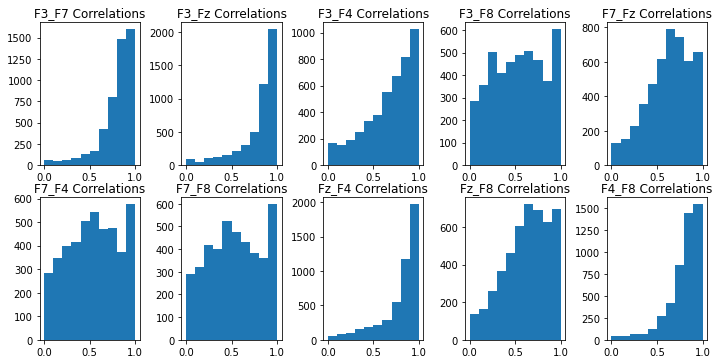

In [222]:
fig, axs = plt.subplots(2, 5)
fig.set_figheight(5)
fig.set_figwidth(10)
fig.tight_layout()
for i in range(2):
    for j in range(5):
        axs[i][j].hist(scalp_frontal_corrs[rows[i][j]], range = (0.0, 1.0))
        axs[i][j].set_title('{} Correlations'.format(rows[i][j]))

plt.show()

##### Pearson by Activity Type: Other

In [223]:
other_correlations = []
for i in activity_sub_eegs:
    labels, correlations = corr(scalp_electrodes, exploratory_preprocessing(other_df, i))
    other_correlations.append(correlations)
    
other_corrs = pd.DataFrame(other_correlations, columns = labels)

In [224]:
other_corrs.describe()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,...,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,0.759496,0.565056,0.451213,0.736174,0.598997,0.437704,0.361592,0.664332,0.427051,0.345089,...,0.505830,0.595281,0.747791,0.749193,0.745767,0.571046,0.437129,0.714046,0.530160,0.743780
std,0.284225,0.343042,0.380466,0.296213,0.311221,0.383440,0.411960,0.374902,0.441271,0.434417,...,0.372914,0.372761,0.327523,0.346269,0.301920,0.354287,0.408518,0.333875,0.396774,0.336375
min,-0.941611,-0.946075,-0.895600,-0.945780,-0.956988,-0.976230,-0.979466,-0.995127,-0.949162,-0.989980,...,-0.927632,-0.932967,-0.960820,-0.966911,-0.976911,-0.918588,-0.978079,-0.942933,-0.978793,-0.971661
25%,0.718310,0.371423,0.190133,0.660227,0.426400,0.209188,0.081277,0.588406,0.148031,0.058173,...,0.285260,0.422817,0.710357,0.717900,0.685630,0.372559,0.168935,0.620611,0.318030,0.694509
50%,0.851174,0.630221,0.458000,0.824694,0.639874,0.429727,0.318065,0.795996,0.522612,0.361798,...,0.522479,0.677045,0.868443,0.881713,0.848167,0.617492,0.461950,0.825583,0.601874,0.865413
75%,0.931095,0.823079,0.769164,0.921478,0.834007,0.746561,0.699494,0.899440,0.756805,0.677795,...,0.832945,0.886101,0.951685,0.958169,0.940778,0.866743,0.782135,0.942011,0.852779,0.947703
max,0.999955,0.999908,0.999912,0.999973,0.999958,0.999942,0.999844,0.999917,0.999790,0.999767,...,0.999973,0.999941,0.999993,0.999972,0.999954,0.999951,0.999983,0.999969,0.999921,0.999994


In [225]:
other_corr_medians = pd.DataFrame(other_corrs.median()).transpose()
other_corr_means = pd.DataFrame(other_corrs.mean()).transpose()
other_corr_mins = pd.DataFrame(other_corrs.min()).transpose()
other_corr_maxs = pd.DataFrame(other_corrs.max()).transpose()

##### Seizure

In [226]:
seizure_correlations = []
for i in activity_sub_eegs:
    labels, correlations = corr(scalp_electrodes, exploratory_preprocessing(seizure_df, i))
    seizure_correlations.append(correlations)
    
seizure_corrs = pd.DataFrame(seizure_correlations, columns = labels)

In [227]:
seizure_corrs.describe()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,...,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,0.715897,0.559514,0.456911,0.715248,0.538339,0.410772,0.364624,0.678619,0.501551,0.428800,...,0.572215,0.675987,0.787169,0.786326,0.796023,0.590195,0.479531,0.740656,0.583206,0.761573
std,0.283226,0.332043,0.350623,0.250907,0.312401,0.366148,0.372886,0.304522,0.376673,0.363969,...,0.315358,0.283788,0.244937,0.245520,0.206299,0.314686,0.362562,0.253393,0.325412,0.254658
min,-0.716575,-0.662933,-0.686256,-0.515079,-0.776185,-0.707007,-0.717664,-0.655769,-0.815650,-0.688254,...,-0.934162,-0.922170,-0.675634,-0.925329,-0.575579,-0.933196,-0.740582,-0.936786,-0.696202,-0.945570
25%,0.615177,0.372605,0.240631,0.605398,0.364478,0.161151,0.089208,0.578517,0.306210,0.189421,...,0.355701,0.549458,0.721416,0.734280,0.736345,0.407019,0.238229,0.650182,0.387131,0.676634
50%,0.819021,0.634732,0.486638,0.789363,0.569038,0.432240,0.345945,0.784994,0.586629,0.460942,...,0.626425,0.745182,0.868019,0.867355,0.850348,0.637150,0.512983,0.808350,0.645956,0.846059
75%,0.906231,0.799453,0.705548,0.891876,0.785360,0.681925,0.653674,0.882270,0.772469,0.684804,...,0.817733,0.878212,0.947009,0.944819,0.931826,0.837221,0.790607,0.917884,0.835100,0.936186
max,0.999988,0.999990,0.999990,0.999994,0.999967,0.999989,0.999988,0.999994,0.999992,0.999990,...,0.999940,0.999988,0.999992,0.999998,0.999946,0.999928,0.999936,0.999982,0.999986,0.999995


In [228]:
seizure_corr_medians = pd.DataFrame(seizure_corrs.median()).transpose()
seizure_corr_means = pd.DataFrame(seizure_corrs.mean()).transpose()
seizure_corr_mins = pd.DataFrame(seizure_corrs.min()).transpose()
seizure_corr_maxs = pd.DataFrame(seizure_corrs.max()).transpose()

##### LPD

In [229]:
lpd_correlations = []
for i in activity_sub_eegs:
    labels, correlations = corr(scalp_electrodes, exploratory_preprocessing(lpd_df, i))
    lpd_correlations.append(correlations)
    
lpd_corrs = pd.DataFrame(lpd_correlations, columns = labels)

In [230]:
lpd_corrs.describe()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,...,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,0.773674,0.558344,0.402338,0.773588,0.562228,0.385763,0.310782,0.738606,0.468857,0.328667,...,0.532336,0.655560,0.784358,0.771005,0.804753,0.619082,0.413843,0.793432,0.551184,0.744007
std,0.274376,0.299733,0.365417,0.206896,0.277681,0.361110,0.383491,0.249712,0.384942,0.372838,...,0.312899,0.324417,0.285490,0.308743,0.226830,0.264905,0.329164,0.234907,0.315488,0.275792
min,-0.979931,-0.601966,-0.981424,-0.380439,-0.906255,-0.931095,-0.879534,-0.727174,-0.941603,-0.979685,...,-0.963402,-0.977414,-0.961077,-0.980650,-0.800996,-0.728115,-0.694070,-0.866817,-0.862831,-0.573145
25%,0.713055,0.362087,0.162550,0.718755,0.403745,0.136677,0.033411,0.678808,0.325929,0.079734,...,0.375108,0.601017,0.781154,0.743226,0.779966,0.479477,0.188759,0.755956,0.388186,0.677666
50%,0.869256,0.605701,0.414801,0.832636,0.587560,0.360071,0.257617,0.822450,0.568445,0.349059,...,0.570870,0.741698,0.869757,0.876220,0.863762,0.652978,0.398965,0.855344,0.604576,0.843380
75%,0.937006,0.780206,0.666400,0.899919,0.749274,0.668279,0.610113,0.888675,0.727842,0.596082,...,0.739248,0.840158,0.926523,0.943571,0.921252,0.819060,0.654500,0.926786,0.771448,0.911361
max,0.999933,0.999964,0.999775,0.999971,0.999875,0.999498,0.999633,0.999953,0.999841,0.999581,...,0.999811,0.999853,0.999984,0.999986,0.999978,0.999852,0.999651,0.999918,0.999851,0.999988


In [231]:
lpd_corr_medians = pd.DataFrame(lpd_corrs.median()).transpose()
lpd_corr_means = pd.DataFrame(lpd_corrs.mean()).transpose()
lpd_corr_mins = pd.DataFrame(lpd_corrs.min()).transpose()
lpd_corr_maxs = pd.DataFrame(lpd_corrs.max()).transpose()

##### GPD

In [232]:
gpd_correlations = []
for i in activity_sub_eegs:
    labels, correlations = corr(scalp_electrodes, exploratory_preprocessing(gpd_df, i))
    gpd_correlations.append(correlations)
    
gpd_corrs = pd.DataFrame(gpd_correlations, columns = labels)

In [233]:
gpd_corrs.describe()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,...,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,0.814332,0.556241,0.392134,0.822406,0.600749,0.378741,0.256939,0.789115,0.454052,0.296294,...,0.446066,0.525051,0.686177,0.820767,0.711436,0.369757,0.294395,0.676643,0.382646,0.689810
std,0.163994,0.280840,0.340290,0.126359,0.198366,0.294743,0.359659,0.182517,0.370772,0.352312,...,0.323810,0.349109,0.371442,0.217983,0.285062,0.406969,0.382211,0.261622,0.400004,0.359531
min,-0.323319,-0.349817,-0.528584,0.015569,-0.068980,-0.520082,-0.758398,-0.602084,-0.845937,-0.731375,...,-0.581053,-0.579086,-0.635531,-0.575883,-0.577369,-0.696406,-0.652043,-0.828275,-0.709872,-0.580478
25%,0.737052,0.361726,0.173010,0.778566,0.492154,0.199249,-0.008492,0.712748,0.252343,0.078420,...,0.224597,0.413448,0.618264,0.783068,0.663428,0.171328,-0.008532,0.548843,0.117129,0.650374
50%,0.861400,0.630192,0.397485,0.844697,0.594720,0.363889,0.221842,0.832322,0.518796,0.308579,...,0.436675,0.597456,0.829776,0.886739,0.787815,0.442905,0.293261,0.734592,0.451554,0.804110
75%,0.928484,0.758256,0.652503,0.900106,0.715507,0.550494,0.511760,0.900889,0.727343,0.518365,...,0.691592,0.746447,0.925888,0.952636,0.887871,0.677311,0.567459,0.873394,0.679869,0.915995
max,0.999918,0.999969,0.998423,0.999857,0.999615,0.998321,0.997923,0.999794,0.998820,0.997785,...,0.998224,0.999168,0.999834,0.999915,0.999884,0.999729,0.999594,0.999905,0.999760,0.999982


In [234]:
gpd_corr_medians = pd.DataFrame(gpd_corrs.median()).transpose()
gpd_corr_means = pd.DataFrame(gpd_corrs.mean()).transpose()
gpd_corr_mins = pd.DataFrame(gpd_corrs.min()).transpose()
gpd_corr_maxs = pd.DataFrame(gpd_corrs.max()).transpose()

##### LRDA

In [235]:
lrda_correlations = []
for i in activity_sub_eegs:
    labels, correlations = corr(scalp_electrodes, exploratory_preprocessing(lrda_df, i))
    lrda_correlations.append(correlations)
    
lrda_corrs = pd.DataFrame(lrda_correlations, columns = labels)

In [236]:
lrda_corrs.describe()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,...,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,0.761729,0.527058,0.370344,0.744541,0.572396,0.392533,0.271832,0.647723,0.345940,0.264831,...,0.477424,0.610173,0.777126,0.766050,0.789266,0.580253,0.382593,0.759583,0.534948,0.739564
std,0.271050,0.344766,0.362449,0.251691,0.281472,0.338712,0.372394,0.332035,0.455492,0.398620,...,0.282458,0.280542,0.222210,0.255692,0.214168,0.267287,0.336881,0.224107,0.307659,0.275576
min,-0.836474,-0.886431,-0.755987,-0.818961,-0.572451,-0.822631,-0.725228,-0.816550,-0.813998,-0.703080,...,-0.530541,-0.809001,-0.508988,-0.597860,-0.645570,-0.427889,-0.751983,-0.753260,-0.760992,-0.591258
25%,0.701951,0.347378,0.140576,0.679368,0.440242,0.177030,-0.022932,0.550548,0.054102,-0.010410,...,0.287851,0.479464,0.711532,0.692600,0.726926,0.431084,0.164136,0.706418,0.387293,0.680665
50%,0.849671,0.604729,0.389272,0.819532,0.608985,0.400793,0.265798,0.744134,0.459260,0.255526,...,0.470202,0.644774,0.847059,0.844793,0.849710,0.625027,0.375167,0.822559,0.575626,0.817808
75%,0.930922,0.781772,0.618959,0.893976,0.769330,0.622346,0.504700,0.855992,0.696992,0.554370,...,0.660862,0.798583,0.919549,0.935379,0.915045,0.755024,0.599021,0.893007,0.729695,0.907581
max,0.999958,0.999613,0.999472,0.999887,0.999838,0.999683,0.999222,0.999698,0.999551,0.999405,...,0.999717,0.999814,0.999833,0.999916,0.999895,0.999765,0.999246,0.999811,0.999745,0.999956


In [237]:
lrda_corr_medians = pd.DataFrame(lrda_corrs.median()).transpose()
lrda_corr_means = pd.DataFrame(lrda_corrs.mean()).transpose()
lrda_corr_mins = pd.DataFrame(lrda_corrs.min()).transpose()
lrda_corr_maxs = pd.DataFrame(lrda_corrs.max()).transpose()

##### GRDA

In [238]:
grda_correlations = []
for i in activity_sub_eegs:
    labels, correlations = corr(scalp_electrodes, exploratory_preprocessing(grda_df, i))
    grda_correlations.append(correlations)
    
grda_corrs = pd.DataFrame(grda_correlations, columns = labels)

In [239]:
grda_corrs.describe()

,Fp1_F3,Fp1_C3,Fp1_P3,Fp1_F7,Fp1_T3,Fp1_T5,Fp1_O1,Fp1_Fz,Fp1_Cz,Fp1_Pz,...,P4_F8,P4_T4,P4_T6,P4_O2,F8_T4,F8_T6,F8_O2,T4_T6,T4_O2,T6_O2
count,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,...,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000,1000.000000
mean,0.780064,0.465024,0.292703,0.747378,0.539838,0.323600,0.191427,0.733831,0.259560,0.166635,...,0.458459,0.639100,0.812619,0.814926,0.792892,0.547868,0.347316,0.754520,0.531271,0.784274
std,0.208761,0.349961,0.381002,0.208533,0.285459,0.338805,0.368157,0.225285,0.480641,0.417257,...,0.292131,0.252418,0.189261,0.225224,0.200909,0.278622,0.329239,0.225335,0.296874,0.218662
min,-0.650922,-0.777724,-0.762288,-0.436086,-0.759992,-0.833631,-0.852186,-0.999217,-0.988279,-0.843018,...,-0.541828,-0.655265,-0.278887,-0.493538,-0.484410,-0.478947,-0.528920,-0.530296,-0.513460,-0.459259
25%,0.713668,0.231394,0.029846,0.680768,0.374343,0.117089,-0.043300,0.663942,-0.099597,-0.139498,...,0.262136,0.515344,0.766015,0.782388,0.747027,0.400370,0.142127,0.674718,0.351136,0.725080
50%,0.837845,0.536483,0.321138,0.799632,0.574976,0.329433,0.157906,0.792445,0.355644,0.147342,...,0.467682,0.681912,0.866189,0.888254,0.846993,0.571755,0.331825,0.818220,0.551823,0.841735
75%,0.915000,0.722703,0.549830,0.878611,0.731256,0.521472,0.399348,0.879977,0.652068,0.460213,...,0.658459,0.804749,0.929082,0.939459,0.910720,0.737436,0.551644,0.900661,0.739034,0.921157
max,0.999976,0.999935,0.999934,0.999970,0.999948,0.999933,0.999910,0.999986,0.999960,0.999925,...,0.999953,0.999961,0.999994,0.999989,0.999985,0.999970,0.999959,0.999994,0.999982,0.999995


In [240]:
grda_corr_medians = pd.DataFrame(grda_corrs.median()).transpose()
grda_corr_means = pd.DataFrame(grda_corrs.mean()).transpose()
grda_corr_mins = pd.DataFrame(grda_corrs.min()).transpose()
grda_corr_maxs = pd.DataFrame(grda_corrs.max()).transpose()

##### Activity Type Pearson Histograms

In [241]:
import matplotlib.pyplot as plt

In [242]:
def activity_histograms(dataframes, pairs, activity_types, h, w):
    fig, axs = plt.subplots(len(pairs), len(dataframes))
    fig.set_figheight(h)
    fig.set_figwidth(w)
    for i in range(len(pairs)):
        for j in range(len(dataframes)):
            axs[i][j].hist(dataframes[j][pairs[i]], range = (0.0, 1.0))
            if len(activity_types) > 1:
                axs[i][j].set_title('{}_{}'.format(activity_types[j], pairs[i]))
            else:
                axs[i][j].set_title('{}_{}'.format(activity_types[0], pairs[i]))
    plt.show()

In [243]:
corr_dfs = [other_corrs, seizure_corrs, lpd_corrs, gpd_corrs, lrda_corrs, grda_corrs]

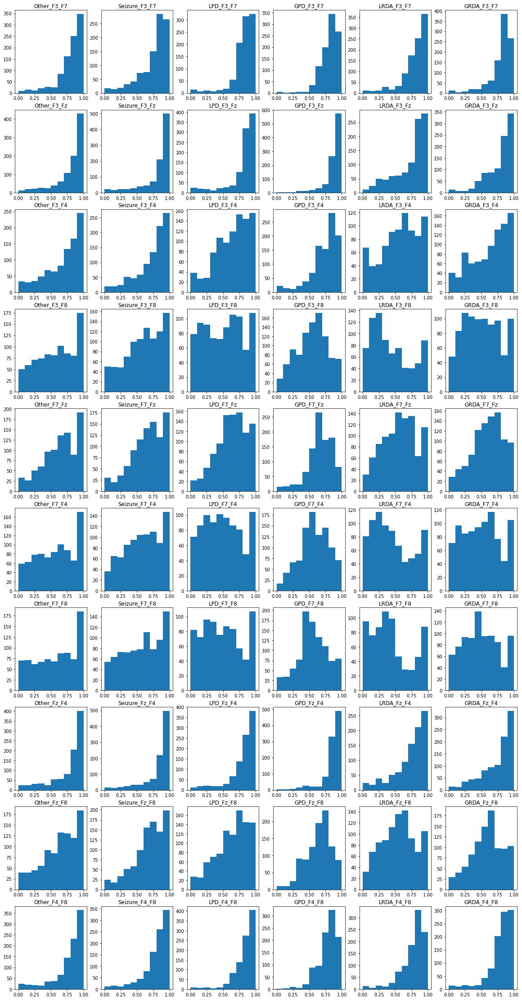

In [244]:
activity_histograms(corr_dfs, frontal_pairs, ['Other', 'Seizure', 'LPD', 'GPD', 'LRDA', 'GRDA'], 40, 20)

### Lateralized vs. Generalized Correlations: Temporal

In [245]:
temporal

['T3', 'T5', 'T4', 'T6']

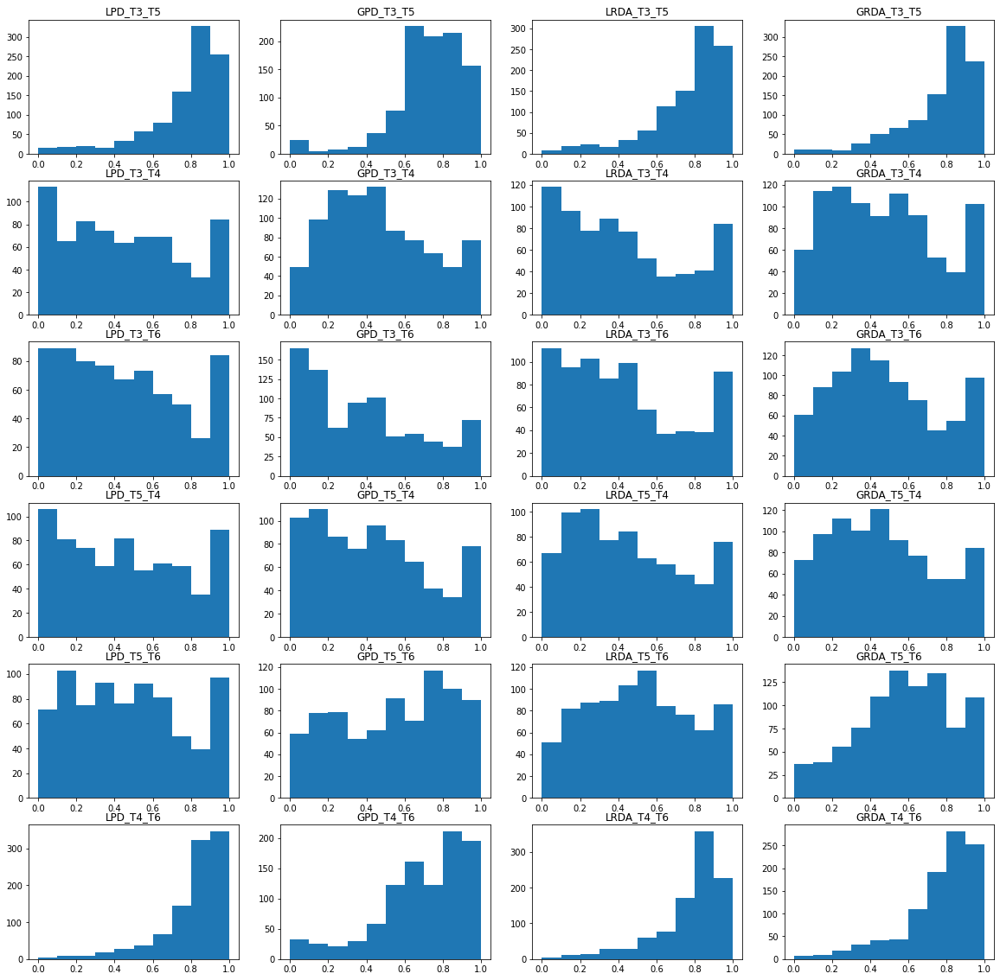

In [246]:
LG_corr_dfs = [lpd_corrs, gpd_corrs, lrda_corrs, grda_corrs]
activity_histograms(LG_corr_dfs, temporal_pairs, ['LPD', 'GPD', 'LRDA', 'GRDA'], 20, 20)

### EEG Visualization

In [143]:
other_df

,eeg_id,eeg_sub_id,eeg_label_offset_seconds,spectrogram_id,spectrogram_sub_id,spectrogram_label_offset_seconds,label_id,patient_id,expert_consensus,seizure_vote,lpd_vote,gpd_vote,lrda_vote,grda_vote,other_vote
0,1202099836,0,0.0,1353070,0,0.0,3051612434,34554,Other,0,0,5,0,0,9
1,3037445252,0,0.0,1730458,0,0.0,3774460362,10187,Other,0,0,1,0,0,2
2,3037445252,1,2.0,1730458,1,2.0,438853598,10187,Other,0,0,1,0,0,2
3,2289322082,0,0.0,1730458,2,270.0,2678832786,10187,Other,0,0,0,0,0,3
4,2289322082,1,2.0,1730458,3,272.0,943195752,10187,Other,0,0,0,0,0,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17580,897183978,3,8.0,2145731520,3,8.0,2911214258,25579,Other,0,0,0,1,0,2
17581,1437016107,0,0.0,2145805074,0,0.0,1221972194,20588,Other,0,0,0,0,0,2
17582,2750557840,0,0.0,2146188334,0,0.0,83367578,21884,Other,0,0,0,0,0,13
17583,2750557840,1,4.0,2146188334,1,4.0,3168355352,21884,Other,0,0,0,0,0,13


In [144]:
o_sub1 = exploratory_preprocessing(other_df, 0)
s_sub1 = exploratory_preprocessing(seizure_df, 0)
lpd_sub1 = exploratory_preprocessing(lpd_df, 0)
gpd_sub1 = exploratory_preprocessing(gpd_df, 0)
lrda_sub1 = exploratory_preprocessing(lrda_df, 0)
grda_sub1 = exploratory_preprocessing(grda_df, 0)

In [145]:
o_sub1 = o_sub1[0:400].reset_index().drop(columns = 'index')
s_sub1 = s_sub1[0:400].reset_index().drop(columns = 'index')
lpd_sub1 = lpd_sub1[0:400].reset_index().drop(columns = 'index')
gpd_sub1 = gpd_sub1[0:400].reset_index().drop(columns = 'index')
lrda_sub1 = lrda_sub1[0:400].reset_index().drop(columns = 'index')
grda_sub1 = grda_sub1[0:400].reset_index().drop(columns = 'index')

In [146]:
def activity_signal_plots(sub_eegs, activities, electrodes, h, w):
    fig, axs = plt.subplots(len(electrodes), len(sub_eegs))
    fig.set_figheight(h)
    fig.set_figwidth(w)
    fig.tight_layout()
    for i in range(len(electrodes)):
        for j in range(len(sub_eegs)):
            axs[i][j].plot(sub_eegs[j][electrodes[i]])
            if len(activities) > 1:
                axs[i][j].set_title('{}_{}'.format(activities[j], electrodes[i]))
            else:
                axs[i][j].set_title('{}_{}'.format(activities[0], electrodes[i]))
    plt.show()

### EEG Signal Plots  
  
The first set of plots are 2 seconds of a sub EEG for each activity type. Columns correspond to activity type (Other, Seizure, LPD, GPD, LRDA, GRDA). Then I plot different intervals of multiple sub EEGs within category of the target variable. So, 5 GRDA sub EEGs plotted next to each other over different intervals, for example.

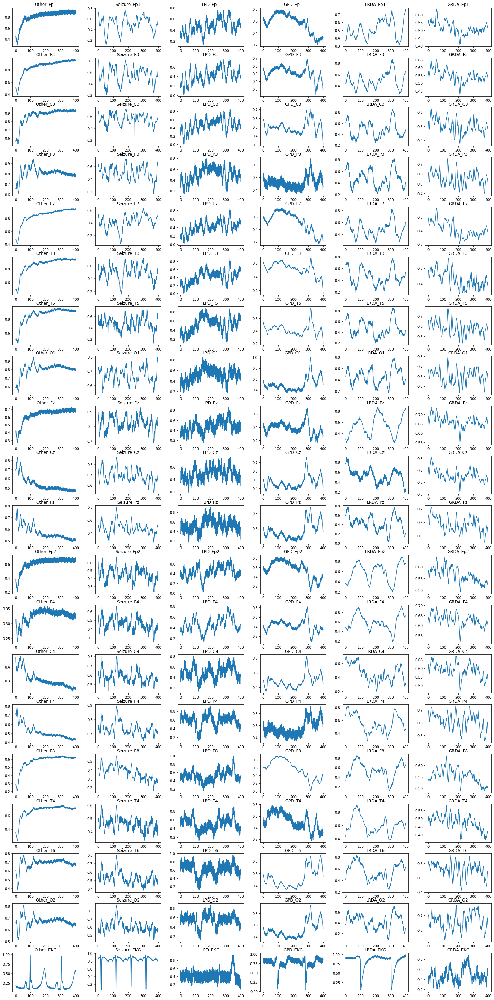

In [147]:
activity_signal_plots([o_sub1, s_sub1, lpd_sub1, gpd_sub1, lrda_sub1, grda_sub1], 
                     ['Other', 'Seizure', 'LPD', 'GPD', 'LRDA', 'GRDA'], o_sub1.columns, 40, 20)

### Between Activity Types 1 Second

In [148]:
o_sub1 = exploratory_preprocessing(other_df, 0)
s_sub1 = exploratory_preprocessing(seizure_df, 0)
lpd_sub1 = exploratory_preprocessing(lpd_df, 0)
gpd_sub1 = exploratory_preprocessing(gpd_df, 0)
lrda_sub1 = exploratory_preprocessing(lrda_df, 0)
grda_sub1 = exploratory_preprocessing(grda_df, 0)

o_sub1 = o_sub1[0:200].reset_index().drop(columns = 'index')
s_sub1 = s_sub1[0:200].reset_index().drop(columns = 'index')
lpd_sub1 = lpd_sub1[0:200].reset_index().drop(columns = 'index')
gpd_sub1 = gpd_sub1[0:200].reset_index().drop(columns = 'index')
lrda_sub1 = lrda_sub1[0:200].reset_index().drop(columns = 'index')
grda_sub1 = grda_sub1[0:200].reset_index().drop(columns = 'index')

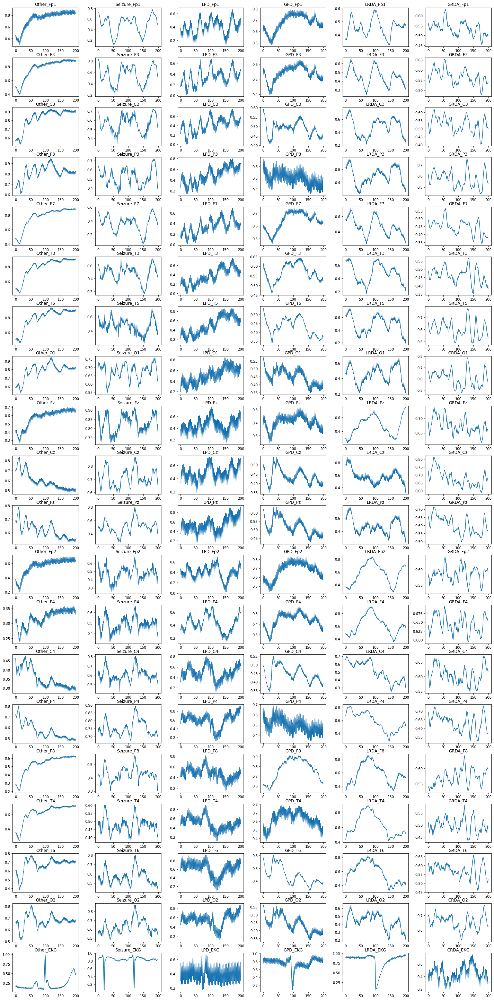

In [149]:
activity_signal_plots([o_sub1, s_sub1, lpd_sub1, gpd_sub1, lrda_sub1, grda_sub1], 
                     ['Other', 'Seizure', 'LPD', 'GPD', 'LRDA', 'GRDA'], o_sub1.columns, 40, 20)

### Between Activity Types 0.5 Seconds

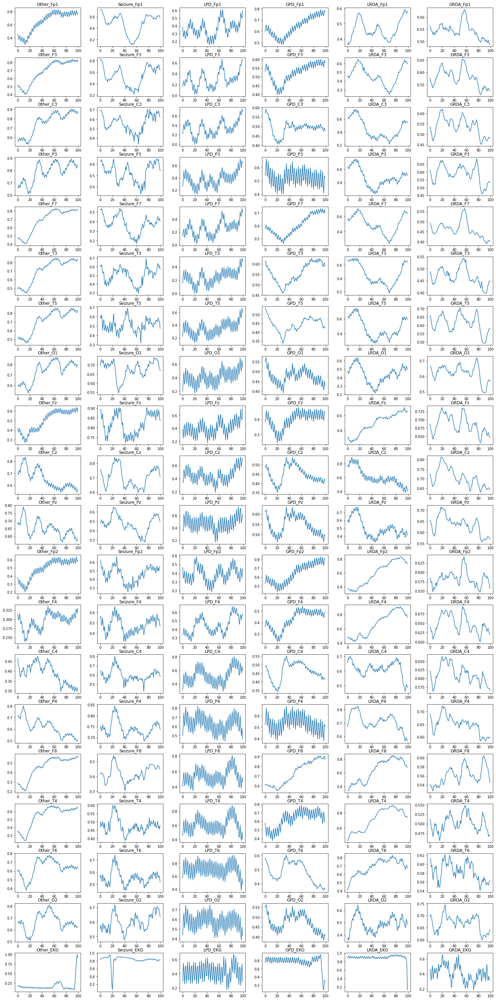

In [150]:
o_sub1 = exploratory_preprocessing(other_df, 0)
s_sub1 = exploratory_preprocessing(seizure_df, 0)
lpd_sub1 = exploratory_preprocessing(lpd_df, 0)
gpd_sub1 = exploratory_preprocessing(gpd_df, 0)
lrda_sub1 = exploratory_preprocessing(lrda_df, 0)
grda_sub1 = exploratory_preprocessing(grda_df, 0)

o_sub1 = o_sub1[0:100].reset_index().drop(columns = 'index')
s_sub1 = s_sub1[0:100].reset_index().drop(columns = 'index')
lpd_sub1 = lpd_sub1[0:100].reset_index().drop(columns = 'index')
gpd_sub1 = gpd_sub1[0:100].reset_index().drop(columns = 'index')
lrda_sub1 = lrda_sub1[0:100].reset_index().drop(columns = 'index')
grda_sub1 = grda_sub1[0:100].reset_index().drop(columns = 'index')

activity_signal_plots([o_sub1, s_sub1, lpd_sub1, gpd_sub1, lrda_sub1, grda_sub1], 
                     ['Other', 'Seizure', 'LPD', 'GPD', 'LRDA', 'GRDA'], o_sub1.columns, 40, 20)

### Seizure Sub EEGs 2 Seconds

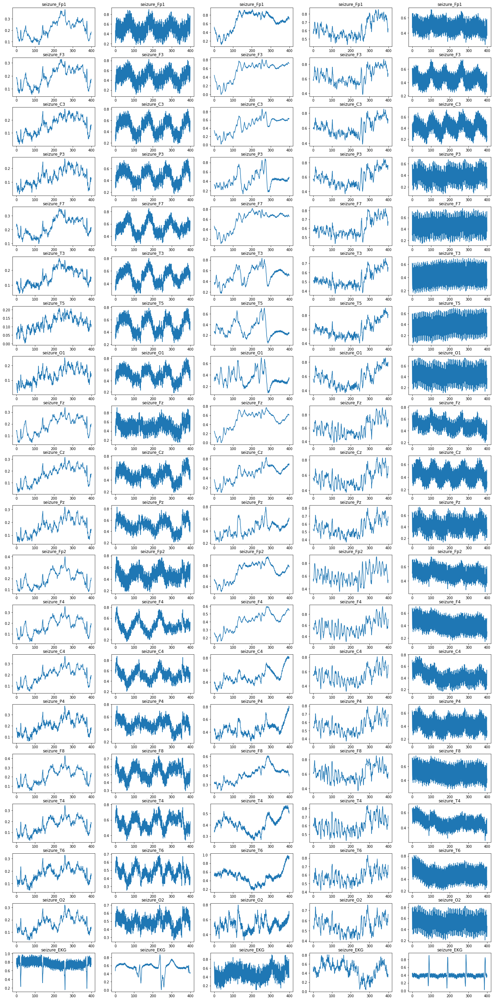

In [151]:
indexes = [i for i in range(seizure_df.shape[0])]
sub_eegs = np.random.choice(indexes, size = 5, replace = False)
s_sub1 = exploratory_preprocessing(seizure_df, sub_eegs[0])
s_sub2 = exploratory_preprocessing(seizure_df, sub_eegs[1])
s_sub3 = exploratory_preprocessing(seizure_df, sub_eegs[2])
s_sub4 = exploratory_preprocessing(seizure_df, sub_eegs[3])
s_sub5 = exploratory_preprocessing(seizure_df, sub_eegs[4])

s_sub1 = s_sub1[0:400].reset_index().drop(columns = 'index')
s_sub2 = s_sub2[0:400].reset_index().drop(columns = 'index')
s_sub3 = s_sub3[0:400].reset_index().drop(columns = 'index')
s_sub4 = s_sub4[0:400].reset_index().drop(columns = 'index')
s_sub5 = s_sub5[0:400].reset_index().drop(columns = 'index')

activity_signal_plots([s_sub1, s_sub2, s_sub3, s_sub4, s_sub5], ['seizure'], s_sub1.columns, 40, 20)


### Seizure Sub EEGs 5 Seconds

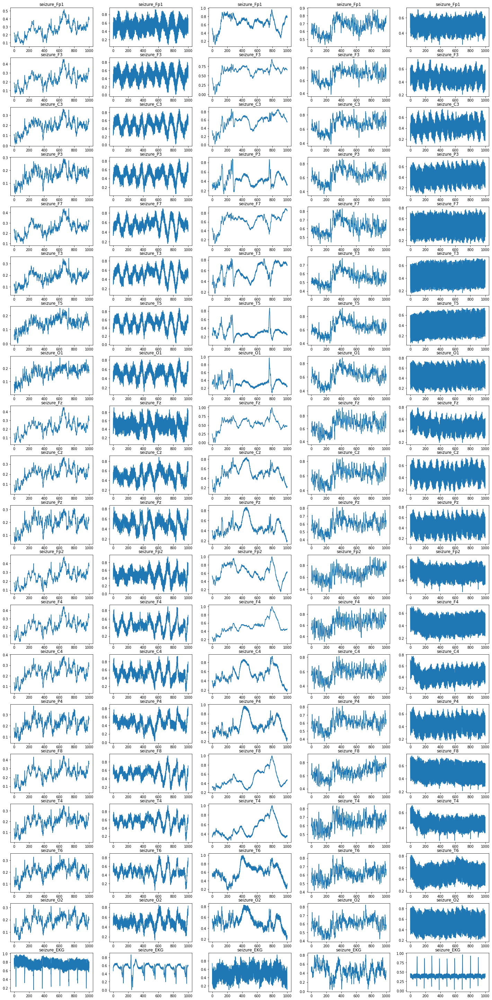

In [152]:
s_sub1 = exploratory_preprocessing(seizure_df, sub_eegs[0])
s_sub2 = exploratory_preprocessing(seizure_df, sub_eegs[1])
s_sub3 = exploratory_preprocessing(seizure_df, sub_eegs[2])
s_sub4 = exploratory_preprocessing(seizure_df, sub_eegs[3])
s_sub5 = exploratory_preprocessing(seizure_df, sub_eegs[4])

s_sub1 = s_sub1[0:1000].reset_index().drop(columns = 'index')
s_sub2 = s_sub2[0:1000].reset_index().drop(columns = 'index')
s_sub3 = s_sub3[0:1000].reset_index().drop(columns = 'index')
s_sub4 = s_sub4[0:1000].reset_index().drop(columns = 'index')
s_sub5 = s_sub5[0:1000].reset_index().drop(columns = 'index')

activity_signal_plots([s_sub1, s_sub2, s_sub3, s_sub4, s_sub5], ['seizure'], s_sub1.columns, 40, 20)


### Seizure Sub EEGs 1 Second

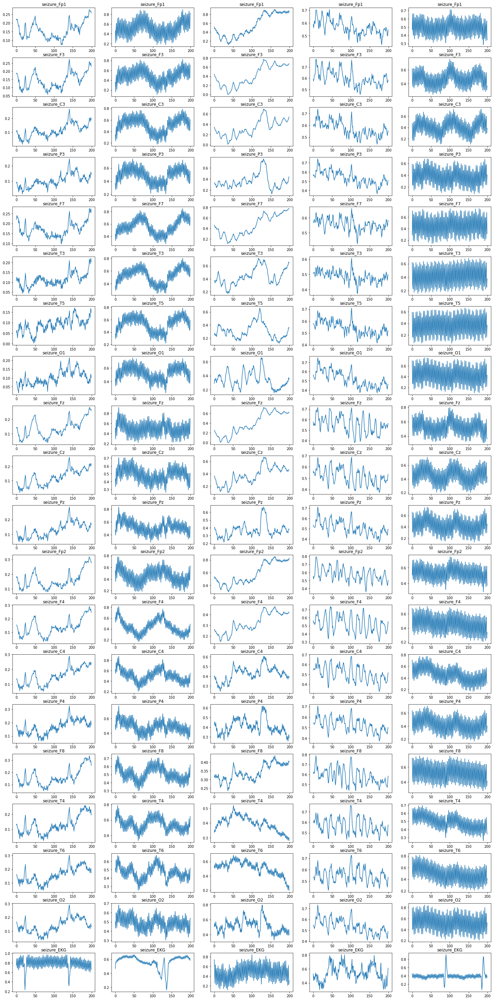

In [153]:
s_sub1 = exploratory_preprocessing(seizure_df, sub_eegs[0])
s_sub2 = exploratory_preprocessing(seizure_df, sub_eegs[1])
s_sub3 = exploratory_preprocessing(seizure_df, sub_eegs[2])
s_sub4 = exploratory_preprocessing(seizure_df, sub_eegs[3])
s_sub5 = exploratory_preprocessing(seizure_df, sub_eegs[4])

s_sub1 = s_sub1[0:200].reset_index().drop(columns = 'index')
s_sub2 = s_sub2[0:200].reset_index().drop(columns = 'index')
s_sub3 = s_sub3[0:200].reset_index().drop(columns = 'index')
s_sub4 = s_sub4[0:200].reset_index().drop(columns = 'index')
s_sub5 = s_sub5[0:200].reset_index().drop(columns = 'index')

activity_signal_plots([s_sub1, s_sub2, s_sub3, s_sub4, s_sub5], ['seizure'], s_sub1.columns, 40, 20)


### Seizure Sub EEGs Full 50 Seconds

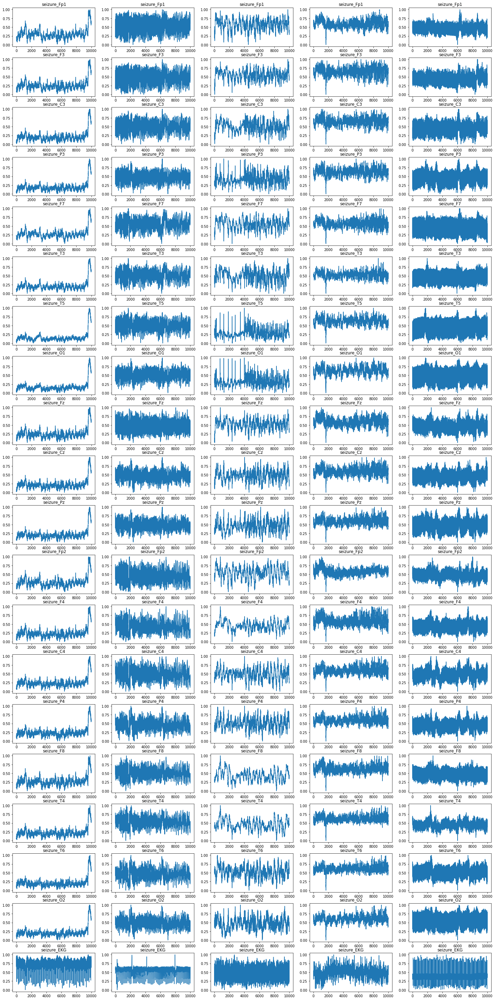

In [154]:
s_sub1 = exploratory_preprocessing(seizure_df, sub_eegs[0])
s_sub2 = exploratory_preprocessing(seizure_df, sub_eegs[1])
s_sub3 = exploratory_preprocessing(seizure_df, sub_eegs[2])
s_sub4 = exploratory_preprocessing(seizure_df, sub_eegs[3])
s_sub5 = exploratory_preprocessing(seizure_df, sub_eegs[4])

activity_signal_plots([s_sub1, s_sub2, s_sub3, s_sub4, s_sub5], ['seizure'], s_sub1.columns, 40, 20)


### GRDA Sub EEGs Full 50 Seconds

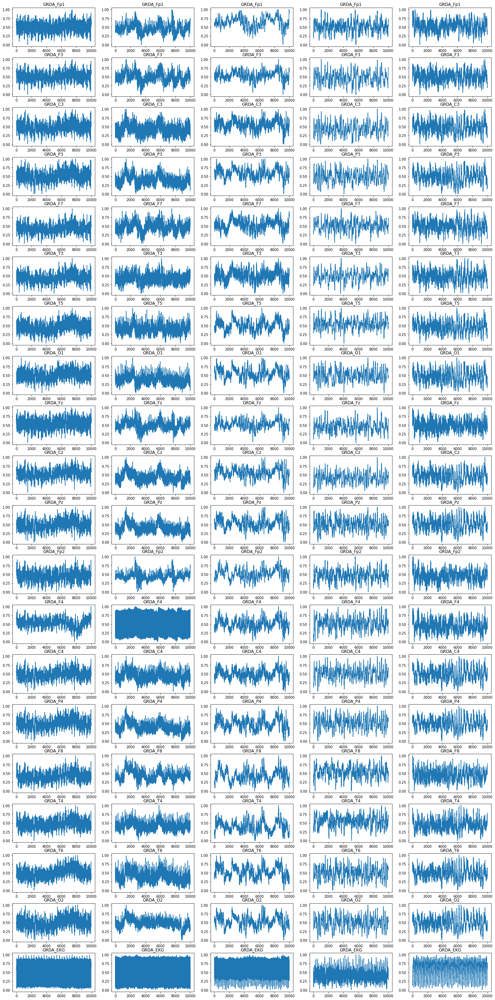

In [155]:
indexes = [i for i in range(grda_df.shape[0])]
sub_eegs = np.random.choice(indexes, size = 5, replace = False)
grda_sub1 = exploratory_preprocessing(grda_df, sub_eegs[0])
grda_sub2 = exploratory_preprocessing(grda_df, sub_eegs[1])
grda_sub3 = exploratory_preprocessing(grda_df, sub_eegs[2])
grda_sub4 = exploratory_preprocessing(grda_df, sub_eegs[3])
grda_sub5 = exploratory_preprocessing(grda_df, sub_eegs[4])

activity_signal_plots([grda_sub1, grda_sub2, grda_sub3, grda_sub4, grda_sub5], ['GRDA'], grda_sub1.columns, 40, 20)


### GRDA Sub EEGs 5 Seconds

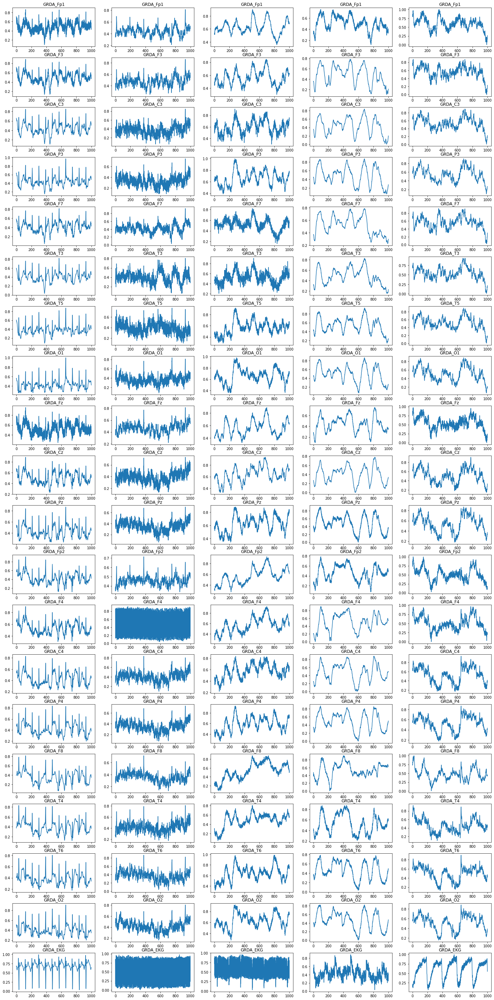

In [156]:
grda_sub1 = exploratory_preprocessing(grda_df, sub_eegs[0])
grda_sub2 = exploratory_preprocessing(grda_df, sub_eegs[1])
grda_sub3 = exploratory_preprocessing(grda_df, sub_eegs[2])
grda_sub4 = exploratory_preprocessing(grda_df, sub_eegs[3])
grda_sub5 = exploratory_preprocessing(grda_df, sub_eegs[4])

grda_sub1 = grda_sub1[0:1000].reset_index().drop(columns = 'index')
grda_sub2 = grda_sub2[0:1000].reset_index().drop(columns = 'index')
grda_sub3 = grda_sub3[0:1000].reset_index().drop(columns = 'index')
grda_sub4 = grda_sub4[0:1000].reset_index().drop(columns = 'index')
grda_sub5 = grda_sub5[0:1000].reset_index().drop(columns = 'index')

activity_signal_plots([grda_sub1, grda_sub2, grda_sub3, grda_sub4, grda_sub5], ['GRDA'], grda_sub1.columns, 40, 20)


### GRDA Sub EEGs 2 Seconds

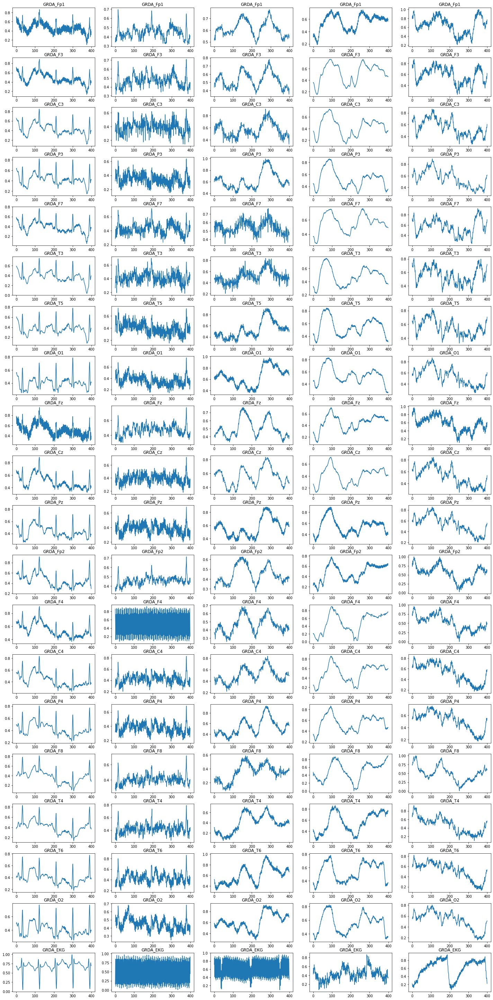

In [157]:
grda_sub1 = exploratory_preprocessing(grda_df, sub_eegs[0])
grda_sub2 = exploratory_preprocessing(grda_df, sub_eegs[1])
grda_sub3 = exploratory_preprocessing(grda_df, sub_eegs[2])
grda_sub4 = exploratory_preprocessing(grda_df, sub_eegs[3])
grda_sub5 = exploratory_preprocessing(grda_df, sub_eegs[4])

grda_sub1 = grda_sub1[0:400].reset_index().drop(columns = 'index')
grda_sub2 = grda_sub2[0:400].reset_index().drop(columns = 'index')
grda_sub3 = grda_sub3[0:400].reset_index().drop(columns = 'index')
grda_sub4 = grda_sub4[0:400].reset_index().drop(columns = 'index')
grda_sub5 = grda_sub5[0:400].reset_index().drop(columns = 'index')

activity_signal_plots([grda_sub1, grda_sub2, grda_sub3, grda_sub4, grda_sub5], ['GRDA'], grda_sub1.columns, 40, 20)


### GRDA Sub EEGs 1 Second

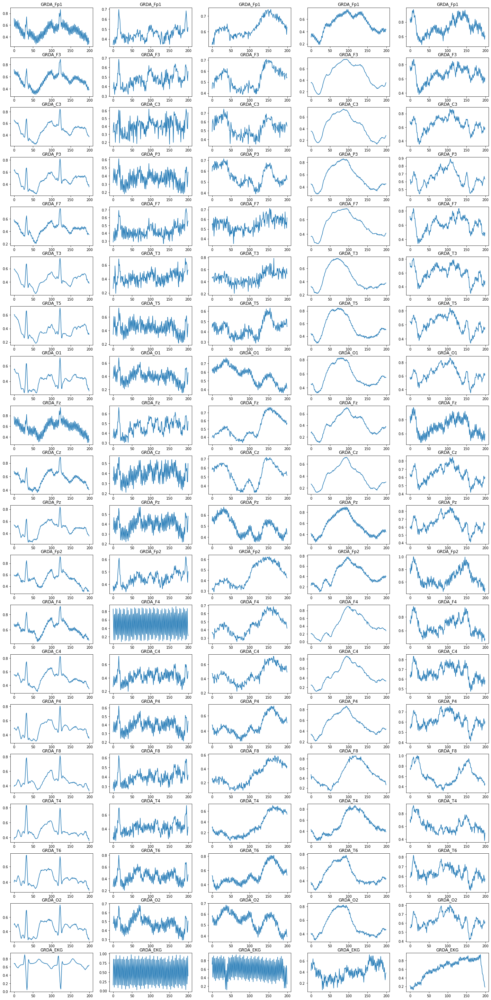

In [158]:
grda_sub1 = exploratory_preprocessing(grda_df, sub_eegs[0])
grda_sub2 = exploratory_preprocessing(grda_df, sub_eegs[1])
grda_sub3 = exploratory_preprocessing(grda_df, sub_eegs[2])
grda_sub4 = exploratory_preprocessing(grda_df, sub_eegs[3])
grda_sub5 = exploratory_preprocessing(grda_df, sub_eegs[4])

grda_sub1 = grda_sub1[0:200].reset_index().drop(columns = 'index')
grda_sub2 = grda_sub2[0:200].reset_index().drop(columns = 'index')
grda_sub3 = grda_sub3[0:200].reset_index().drop(columns = 'index')
grda_sub4 = grda_sub4[0:200].reset_index().drop(columns = 'index')
grda_sub5 = grda_sub5[0:200].reset_index().drop(columns = 'index')

activity_signal_plots([grda_sub1, grda_sub2, grda_sub3, grda_sub4, grda_sub5], ['GRDA'], grda_sub1.columns, 40, 20)


### GPD Sub EEGs Full 50 Seconds

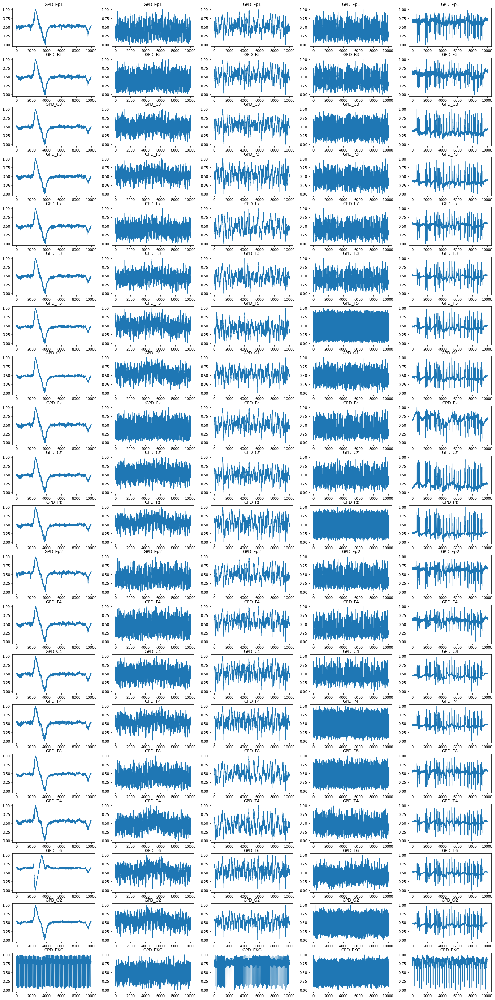

In [159]:
indexes = [i for i in range(gpd_df.shape[0])]
sub_eegs = np.random.choice(indexes, size = 5, replace = False)
gpd_sub1 = exploratory_preprocessing(gpd_df, sub_eegs[0])
gpd_sub2 = exploratory_preprocessing(gpd_df, sub_eegs[1])
gpd_sub3 = exploratory_preprocessing(gpd_df, sub_eegs[2])
gpd_sub4 = exploratory_preprocessing(gpd_df, sub_eegs[3])
gpd_sub5 = exploratory_preprocessing(gpd_df, sub_eegs[4])

activity_signal_plots([gpd_sub1, gpd_sub2, gpd_sub3, gpd_sub4, gpd_sub5], ['GPD'], gpd_sub1.columns, 40, 20)


### GPD Sub EEGs 5 Seconds

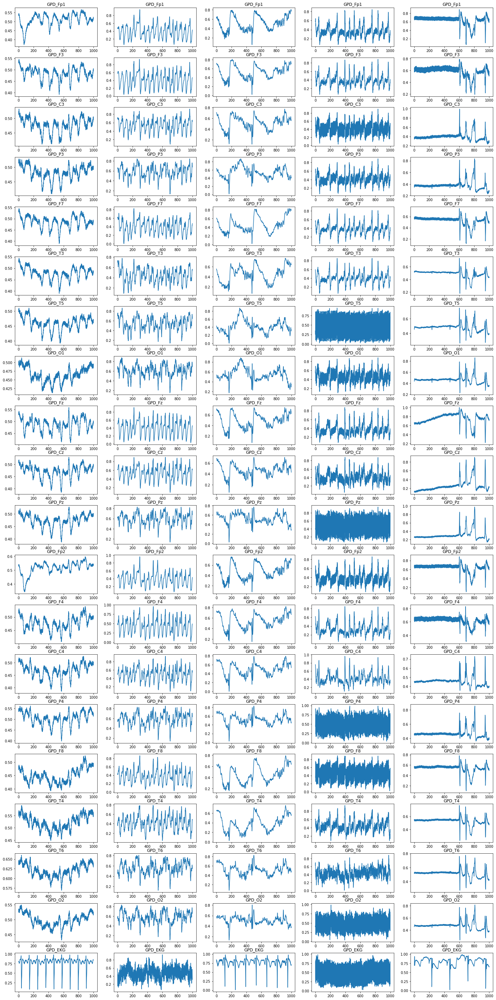

In [160]:
gpd_sub1 = exploratory_preprocessing(gpd_df, sub_eegs[0])
gpd_sub2 = exploratory_preprocessing(gpd_df, sub_eegs[1])
gpd_sub3 = exploratory_preprocessing(gpd_df, sub_eegs[2])
gpd_sub4 = exploratory_preprocessing(gpd_df, sub_eegs[3])
gpd_sub5 = exploratory_preprocessing(gpd_df, sub_eegs[4])

gpd_sub1 = gpd_sub1[0:1000].reset_index().drop(columns = 'index')
gpd_sub2 = gpd_sub2[0:1000].reset_index().drop(columns = 'index')
gpd_sub3 = gpd_sub3[0:1000].reset_index().drop(columns = 'index')
gpd_sub4 = gpd_sub4[0:1000].reset_index().drop(columns = 'index')
gpd_sub5 = gpd_sub5[0:1000].reset_index().drop(columns = 'index')

activity_signal_plots([gpd_sub1, gpd_sub2, gpd_sub3, gpd_sub4, gpd_sub5], ['GPD'], gpd_sub1.columns, 40, 20)


### GPD Sub EEGs 2 Seconds

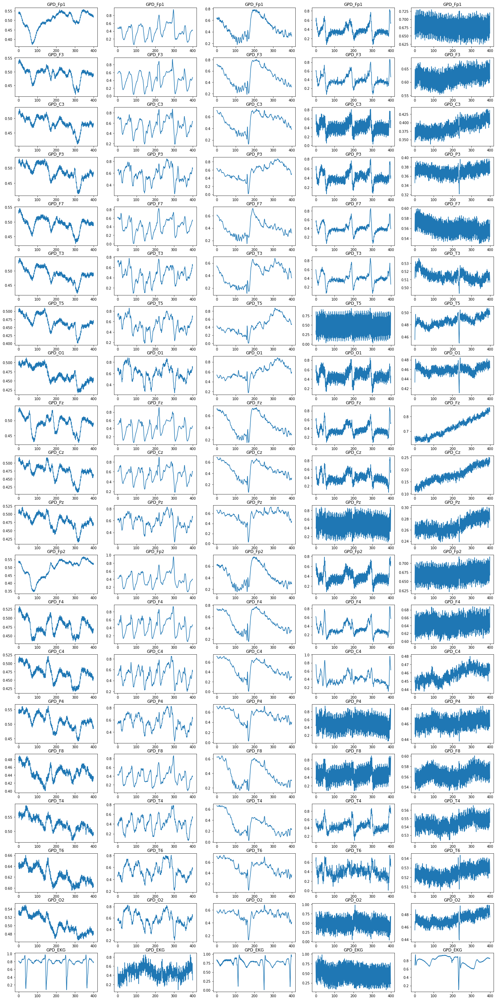

In [161]:
gpd_sub1 = exploratory_preprocessing(gpd_df, sub_eegs[0])
gpd_sub2 = exploratory_preprocessing(gpd_df, sub_eegs[1])
gpd_sub3 = exploratory_preprocessing(gpd_df, sub_eegs[2])
gpd_sub4 = exploratory_preprocessing(gpd_df, sub_eegs[3])
gpd_sub5 = exploratory_preprocessing(gpd_df, sub_eegs[4])

gpd_sub1 = gpd_sub1[0:400].reset_index().drop(columns = 'index')
gpd_sub2 = gpd_sub2[0:400].reset_index().drop(columns = 'index')
gpd_sub3 = gpd_sub3[0:400].reset_index().drop(columns = 'index')
gpd_sub4 = gpd_sub4[0:400].reset_index().drop(columns = 'index')
gpd_sub5 = gpd_sub5[0:400].reset_index().drop(columns = 'index')

activity_signal_plots([gpd_sub1, gpd_sub2, gpd_sub3, gpd_sub4, gpd_sub5], ['GPD'], gpd_sub1.columns, 40, 20)


### GPD Sub EEGs 1 Second

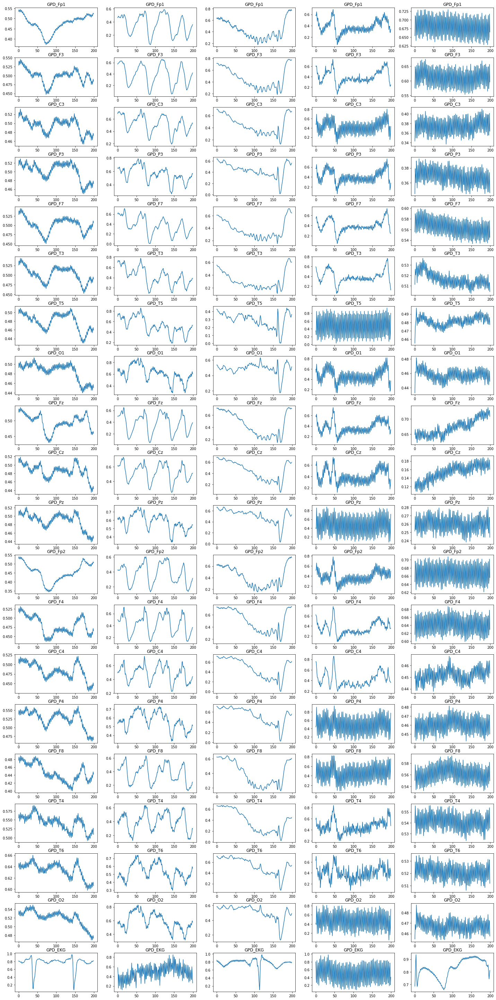

In [162]:
gpd_sub1 = exploratory_preprocessing(gpd_df, sub_eegs[0])
gpd_sub2 = exploratory_preprocessing(gpd_df, sub_eegs[1])
gpd_sub3 = exploratory_preprocessing(gpd_df, sub_eegs[2])
gpd_sub4 = exploratory_preprocessing(gpd_df, sub_eegs[3])
gpd_sub5 = exploratory_preprocessing(gpd_df, sub_eegs[4])

gpd_sub1 = gpd_sub1[0:200].reset_index().drop(columns = 'index')
gpd_sub2 = gpd_sub2[0:200].reset_index().drop(columns = 'index')
gpd_sub3 = gpd_sub3[0:200].reset_index().drop(columns = 'index')
gpd_sub4 = gpd_sub4[0:200].reset_index().drop(columns = 'index')
gpd_sub5 = gpd_sub5[0:200].reset_index().drop(columns = 'index')

activity_signal_plots([gpd_sub1, gpd_sub2, gpd_sub3, gpd_sub4, gpd_sub5], ['GPD'], gpd_sub1.columns, 40, 20)


### GPD Sub EEGs 0.5 Seconds

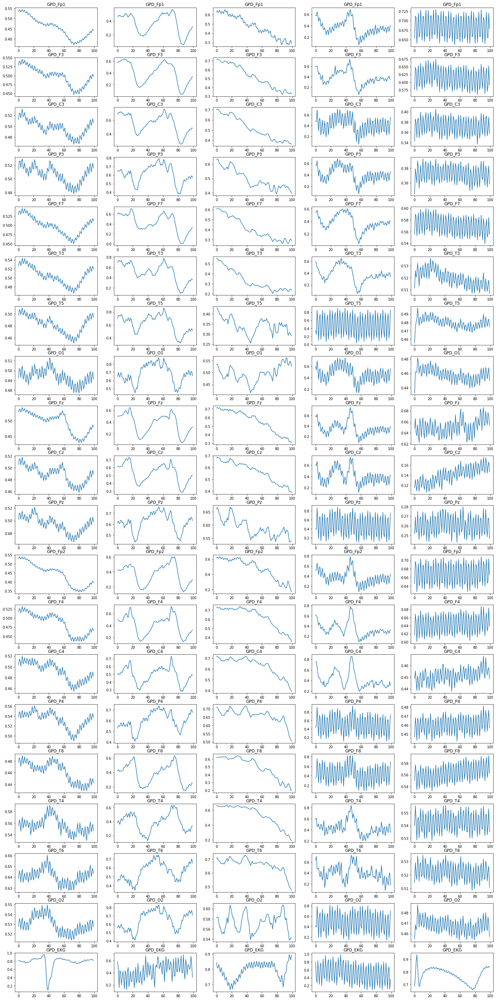

In [163]:
gpd_sub1 = exploratory_preprocessing(gpd_df, sub_eegs[0])
gpd_sub2 = exploratory_preprocessing(gpd_df, sub_eegs[1])
gpd_sub3 = exploratory_preprocessing(gpd_df, sub_eegs[2])
gpd_sub4 = exploratory_preprocessing(gpd_df, sub_eegs[3])
gpd_sub5 = exploratory_preprocessing(gpd_df, sub_eegs[4])

gpd_sub1 = gpd_sub1[0:100].reset_index().drop(columns = 'index')
gpd_sub2 = gpd_sub2[0:100].reset_index().drop(columns = 'index')
gpd_sub3 = gpd_sub3[0:100].reset_index().drop(columns = 'index')
gpd_sub4 = gpd_sub4[0:100].reset_index().drop(columns = 'index')
gpd_sub5 = gpd_sub5[0:100].reset_index().drop(columns = 'index')

activity_signal_plots([gpd_sub1, gpd_sub2, gpd_sub3, gpd_sub4, gpd_sub5], ['GPD'], gpd_sub1.columns, 40, 20)


### Lateralized vs. Generalized 2 Seconds

In [164]:
indexes = [i for i in range(lpd_df.shape[0])]
sub_eeg_choice = np.random.choice(indexes, size = 1)

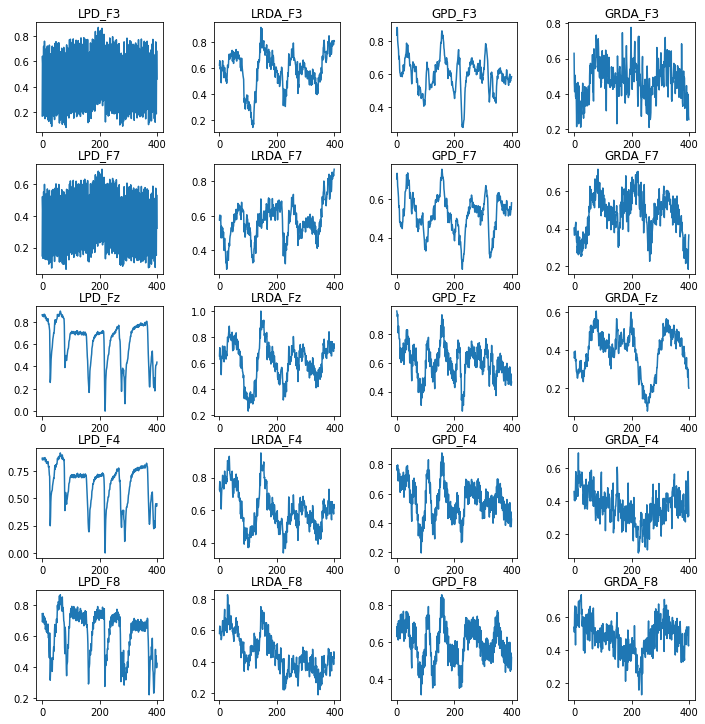

In [165]:
lpd_sub = exploratory_preprocessing(lpd_df, sub_eeg_choice[0])
lrda_sub = exploratory_preprocessing(lrda_df, sub_eeg_choice[0])
gpd_sub = exploratory_preprocessing(gpd_df, sub_eeg_choice[0])
grda_sub = exploratory_preprocessing(grda_df, sub_eeg_choice[0])

lpd_sub = lpd_sub[0:400].reset_index().drop(columns = 'index')
lrda_sub = lrda_sub[0:400].reset_index().drop(columns = 'index')
gpd_sub = gpd_sub[0:400].reset_index().drop(columns = 'index')
grda_sub = grda_sub[0:400].reset_index().drop(columns = 'index')

activity_signal_plots([lpd_sub, lrda_sub, gpd_sub, grda_sub], ['LPD', 'LRDA', 'GPD', 'GRDA'], frontal, 10, 10)


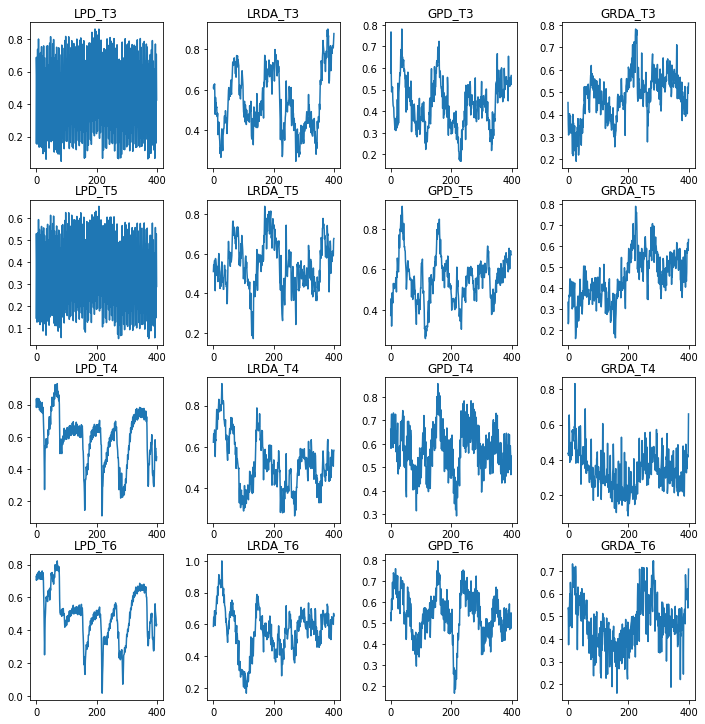

In [166]:
activity_signal_plots([lpd_sub, lrda_sub, gpd_sub, grda_sub], ['LPD', 'LRDA', 'GPD', 'GRDA'], temporal, 10, 10)
